# Plots for Busecke et al. 2022 

This Notebook contains the code to reproduce Figures 1/4/5/7 and the map in Figure 6, as well as the supplementary figures S1-4 and S6-10.

The appearance of the final Figures has been further touched up with Adobe illustrator, but these changes are restricted to labelling and arranging panels.

> TODO for revision:

- Replace all the paths to local directory.
- Test if all runs
- Test binder
- Refactor as the main notebook

In [1]:
# uncomment and run to download the data (needs to be done only once in either notebook and takes a while)
# !cd ../ && ./scripts/download_zenodo_files.sh

In [2]:
import pathlib
import os
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cmocean.cm as cmo
import cartopy.crs as ccrs
from xhistogram.xarray import histogram
import pandas as pd
from xgcm import Grid

from xarrayutils.utils import xr_linregress, sign_agreement, linear_trend
from xarrayutils.filtering import filter_2D
from xarrayutils.plotting import linear_piecewise_scale, letter_subplots, shaded_line_plot

from cmip6_omz.units import convert_mol_m3_mymol_kg
from cmip6_omz.omz_tools import mask_basin

from busecke_etal_2022_aguadv.plotting import (
    o2_model_colors,
    model_color_legend,
    mask_multi_model,
    polish_map,
    ScientificManualFormatter
)
from busecke_etal_2022_aguadv.utils import (
    load_directory,
    fail_age,
    slope,
    trend_slice,
    regrid,
)

import warnings
warnings.filterwarnings("ignore")

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

## Global Parmeters

In [3]:
zkwargs = {"use_cftime": True, "consolidated": True}

core_o2 = 20
middle_o2 = 60
outer_o2 = 120
o2_th = [core_o2, middle_o2, outer_o2]
contour_lines = o2_th

projection = ccrs.Robinson(210)
map_kwargs = dict(x='lon', y='lat', transform=ccrs.PlateCarree())
single_figsize_y = 4
single_figsize_x = 8

sign_threshold = 0.6

section_bounds = [200, 230]

map_section_unit_cmap_dict = {
    "o2":{'full_name':"Oxygen",'name':'Oxygen change', 'units':'$\mu$mol/kg/century', 'cmap':'RdBu_r'},
    "epc100":{'full_name':"Particulate Export" ,'name':'Particulate Organic Carbon Flux change', 'units':'mol/$m^2$/s/century', 'cmap':'RdBu'},
    'agessc':{'full_name':"Ideal Age" ,'name':'Ideal Age change', 'units':'yrs/century', 'cmap':'RdBu'},
    "aou":{'full_name':"AOU" ,'name':'Apparent Oxygen Utilization change', 'units':'$\mu$mol/kg/century', 'cmap':'RdBu'},
    "o2sat":{'full_name':"o2sat" ,'name':'Saturation Oxygen Concentration change', 'units':'$\mu$mol/kg/century', 'cmap':'RdBu_r'},
}

pfolder = pathlib.Path('../plots/')


# make sure the plot folder is empty
for f in pfolder.glob('*'):
    if f.stem[0] != '.':
        os.remove(f)
        print(f"Deleted {f}")

# for development use local path
# dfolder = pathlib.Path('/projects/GEOCLIM/LRGROUP/jbusecke/projects/busecke_etal_2022_aguadv/data/processed_revision_2.2/')

#second level check with data collected via copying
# dfolder = pathlib.Path('/projects/GEOCLIM/LRGROUP/jbusecke/projects/busecke_etal_2022_aguadv/data/processed_collect_revision_2_copied/')


# third level check with collected folder that was cleanly reprocessed (for the final version)
# dfolder = pathlib.Path('/projects/GEOCLIM/LRGROUP/jbusecke/projects/busecke_etal_2022_aguadv/data/processed_collect_revision_2/')

dfolder = pathlib.Path('../data/data')

## Custom Functions

In [4]:
def make_mask(ds, threshold, var='historical_o2_min_value'):
    # convert o2 value units
    o2 = convert_mol_m3_mymol_kg(ds[var])
    if 'time' in o2.dims:
        o2 = o2.mean('time')
    mask = (o2<threshold) # shoulf focus only on the real core
    return mask

def smooth(ds):
    ds = filter_2D(ds, 2, ["y", 'x'])
    return ds

def _mask_fail_age(ds):
    if fail_age(ds):
        ds['agessc'] = xr.ones_like(ds.agessc) * np.nan
    return ds

## Load Data

In [5]:
# load map data
depth_pattern = '100-3000m'

ds_combo_o2 = xr.open_zarr(dfolder.joinpath(f"combined_o2_{depth_pattern}.zarr")).o2
ds_combo_epc100 = xr.open_zarr(dfolder.joinpath(f"combined_epc100_{depth_pattern}.zarr")).epc100
ds_combo_age = xr.open_zarr(dfolder.joinpath(f"combined_agessc_{depth_pattern}.zarr")).agessc
ds_combo_o2sat = xr.open_zarr(dfolder.joinpath(f"combined_o2sat_{depth_pattern}.zarr")).o2sat
ds_combo_aou = -xr.open_zarr(dfolder.joinpath(f"combined_aou_{depth_pattern}.zarr")).aou
# ds_combo_o2residual = ds_combo_o2sat+ds_combo_aou

# boundary
ds_boundary_combined = xr.open_zarr(dfolder.joinpath('boundary_combined.zarr'), use_cftime=True)

# sections
ds_full_3d_changes = xr.open_dataset(dfolder.joinpath('full_3d_changes_combined.nc'))

# Read in for Plots from Sam

dir_path = '../data/data/'

path_historical_volume = dir_path + 'historical_volume/'
path_volume_trend = dir_path + 'volume_trend/'
path_volume_time_series = dir_path + 'OMZ_time_series4/'
path_o2_decomp = dir_path + 'o2_decomposition/'

path_epc_core = dir_path + 'epc100_core/'
path_epc_full = dir_path + 'epc100_full_basin/'

# Read in Historical Volume Files
# These are used for Figure 2

ofolder = pathlib.Path(path_historical_volume)
flist = list(ofolder.glob('*'))
results_historical_volume = {}
for f in flist:
    if str(f.stem) == 'obs':
        obs_historical_volume = xr.open_dataset(str(f),use_cftime=True)
    else:
        ds = xr.open_dataset(str(f),use_cftime=True)
        results_historical_volume[f.stem] = ds 
        
# Read in Volume trend files
# These are used for Figure 3a

ofolder = pathlib.Path(path_volume_trend)
flist = list(ofolder.glob('*'))
results_volume_trend = {}
for f in flist:
    ds = xr.open_dataset(str(f),use_cftime=True)
    results_volume_trend[f.stem] = ds
    
# Read in Volume time series files
# These are used for Figure 3ceg
# and to create the tables S1, S2, S3

ofolder = pathlib.Path(path_volume_time_series)
flist = list(ofolder.glob('*'))
results_vol_ts = {}
for f in flist:
    ds = xr.open_dataset(str(f),use_cftime=True)
    ds.attrs['source_id'] = str(f.stem).split('_')[0]
    results_vol_ts[f.stem] = ds
    
#read in observations from WOA
#this is used in Tables S1, S2, S3
obs_histogram = xr.open_zarr(dir_path + 'obs.zarr')

# Read in o2 decomposition files
# These are used for Figure 3bdfh

ofolder = pathlib.Path(path_o2_decomp)
flist = list(ofolder.glob('*'))
results_o2_decomp = {}
for f in flist:
    ds = xr.open_dataset(str(f),use_cftime=True)
    results_o2_decomp[f.stem] = ds
    
# Read in epc100 processed files
# These are used for Figure 3bdfh

ofolder = pathlib.Path(path_epc_core)
flist = list(ofolder.glob('*'))
results_epc_core = {}
for f in flist:
    ds = xr.open_zarr(str(f),use_cftime=True)
    results_epc_core[f.stem] = ds
    
ofolder = pathlib.Path(path_epc_full)
flist = list(ofolder.glob('*'))
results_epc_outer = {}
for f in flist:
    ds = xr.open_zarr(str(f),use_cftime=True)
    results_epc_outer[f.stem] = ds

## Figure 1: OMZ validation

OMZ boundary 20


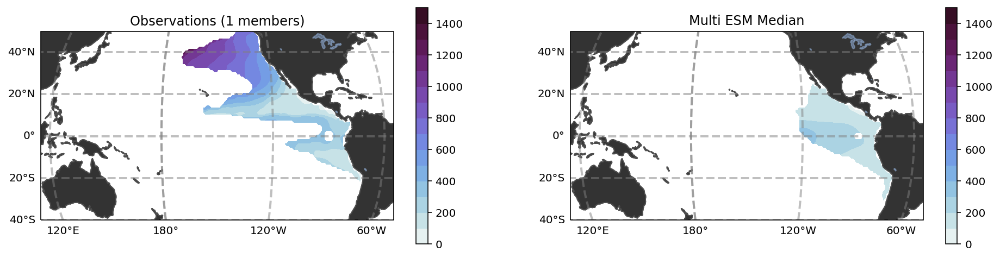

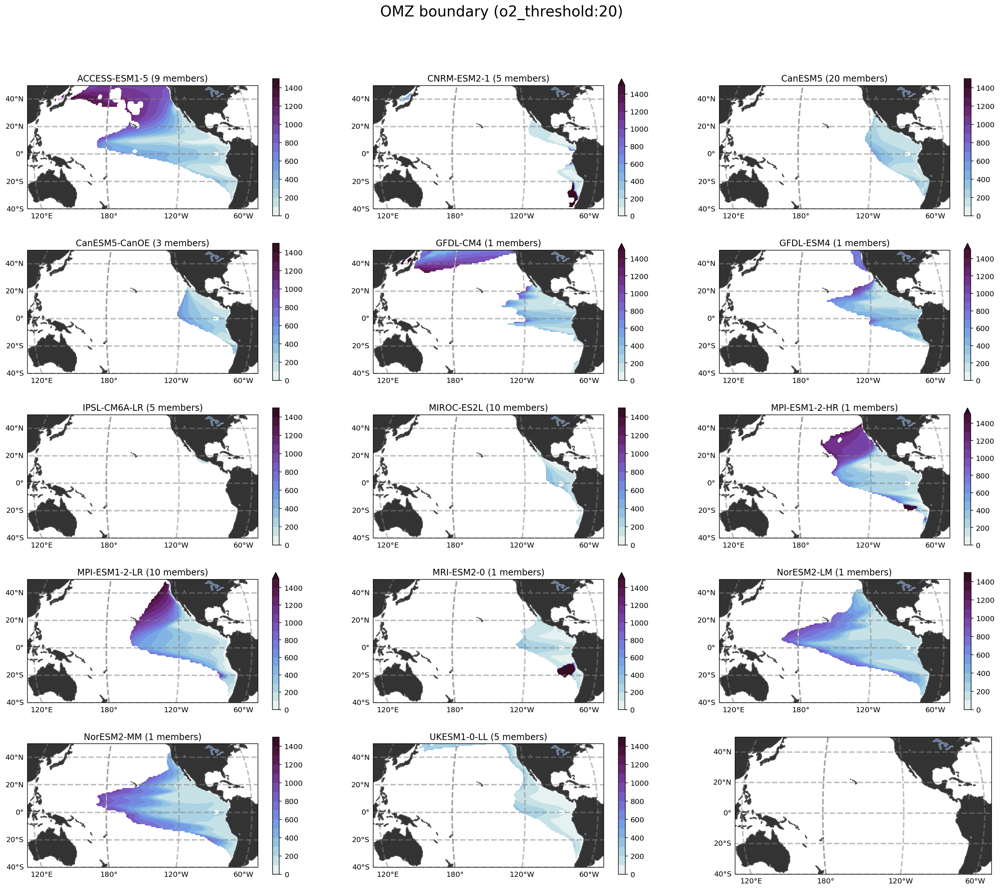

Minimum o2 20


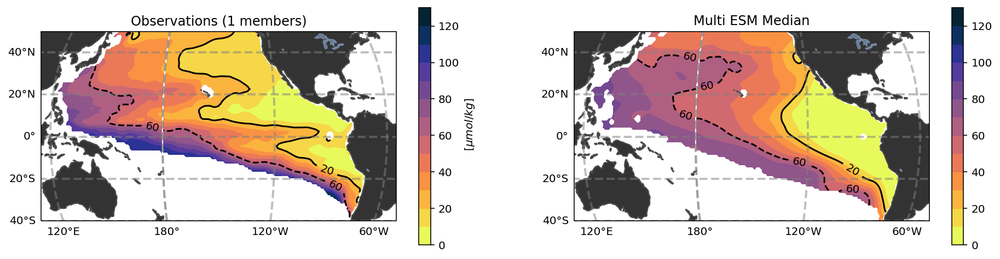

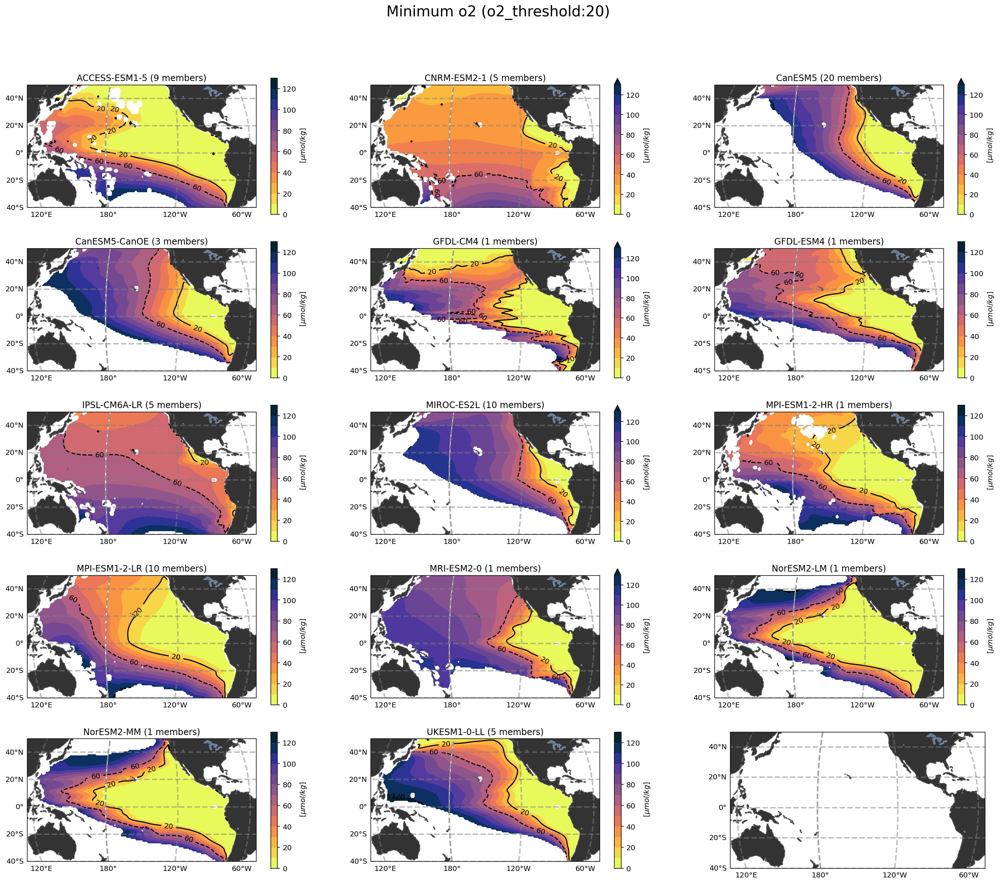

OMZ boundary 60


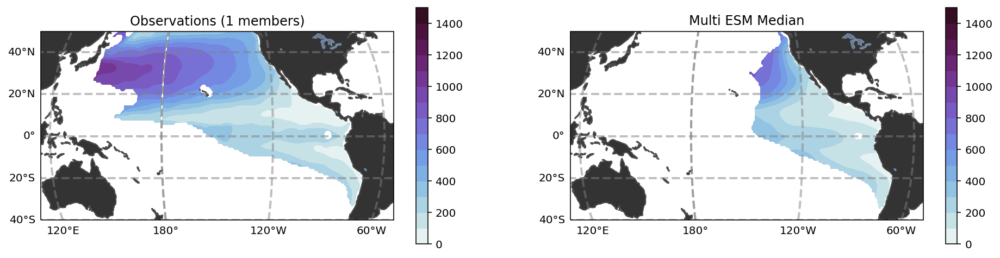

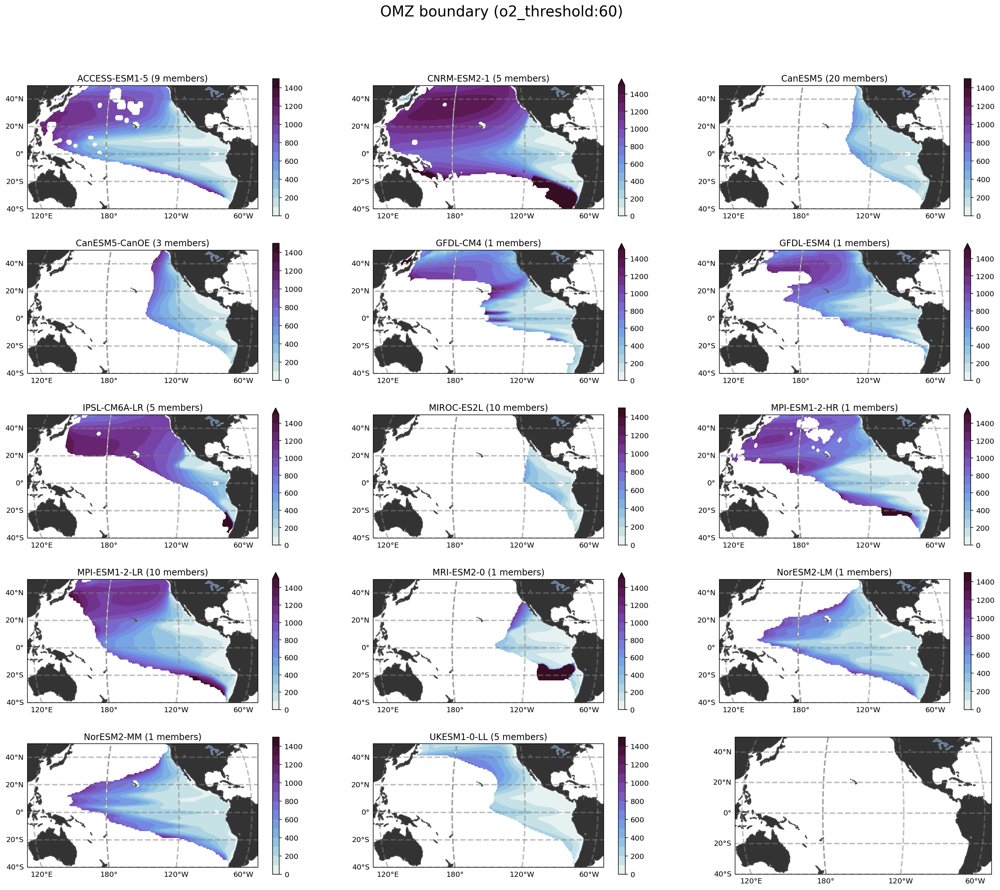

OMZ boundary 120


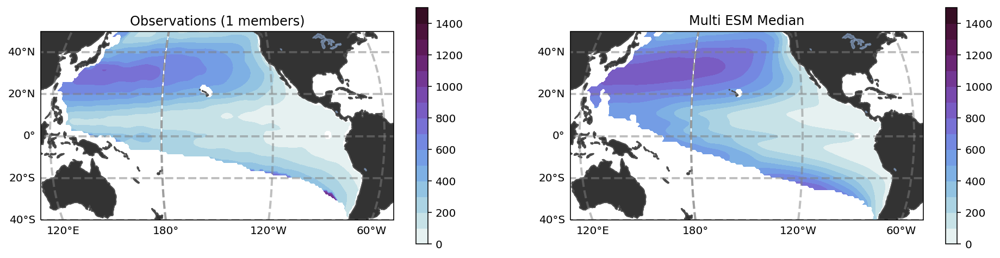

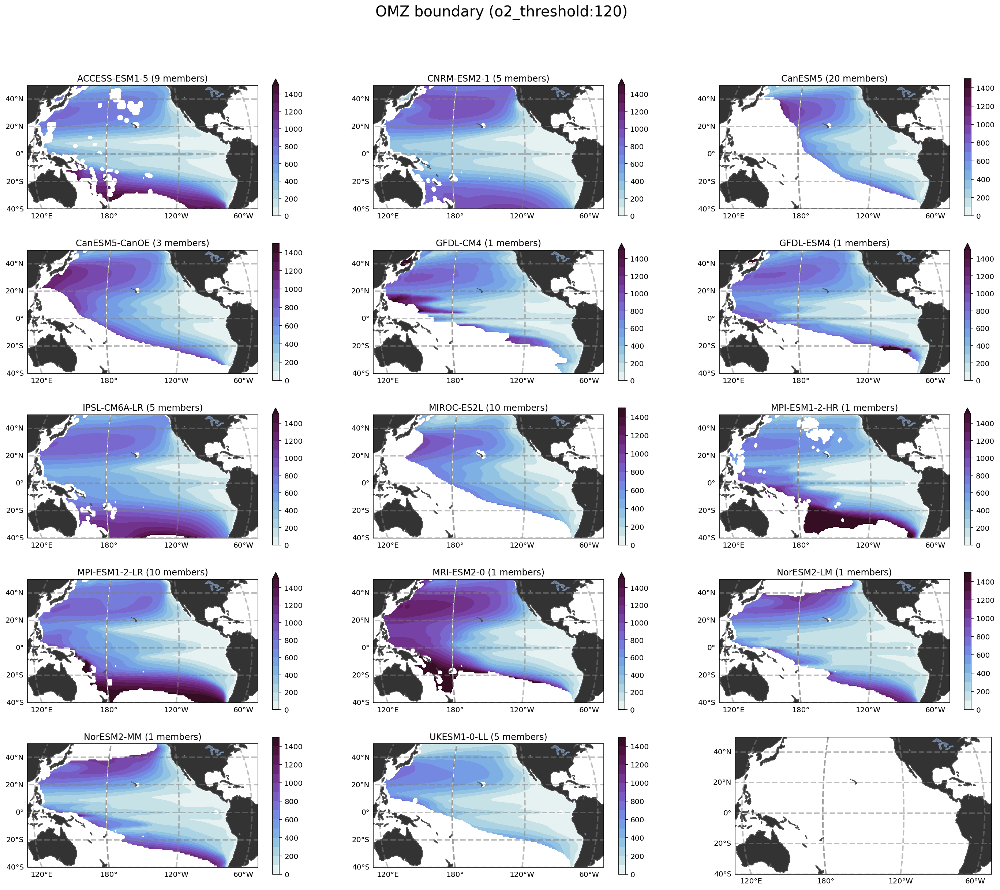

In [6]:
obs = regrid(ds_boundary_combined.sel(model='obs_bianchi').load())

for o2_threshold in [core_o2, middle_o2, outer_o2]:
    for title, vmin, vmax, cmap, levels in [
        ("OMZ boundary", 0, 1500, cmo.dense, 16),
        ("Minimum o2", 0, 130, cmo.thermal_r, 14),
    ]:
        if title == 'Minimum o2' and o2_threshold != core_o2:
            pass
        else:
            p_datasets = []
            p_contour_datasets = []

            print(f"{title} {o2_threshold}")
            fig_final, (ax_obs, ax_mmm) = plt.subplots(
                ncols=2,
                figsize=[single_figsize_x * 2, single_figsize_y],
                subplot_kw={"projection": projection},
            )

            fig, axarr = plt.subplots(
                ncols=3,
                nrows=5,
                figsize=[single_figsize_x * 3, single_figsize_y * 5],
                subplot_kw={"projection": projection},
            )

            ax_counter = 0

            for name in ds_boundary_combined.model.data:
                if 'obs' in name:
                    ax = ax_obs
                else:
                    ax = axarr.flat[ax_counter]
                    ax_counter += 1

                # specific to the plot

                ds = ds_boundary_combined.sel(model=name)
                averaged_members = ds.averaged_members.data
                # mask land
                ds = ds.where(ds.historical_o2_min_value < 1000)

                broad_o2_threshold = outer_o2+40
                # mask broadly for all plots
                ds = ds.where(make_mask(ds, broad_o2_threshold))
                # further mask for areas with near zero thickness (problem with the original algo)
                thickness = (ds.historical_lower_boundary - ds.historical_upper_boundary)
                another_mask = thickness.sel(o2_threshold=outer_o2)>1

                ds = ds.where(another_mask)

                map_kwargs = dict(x="lon", y="lat", transform=ccrs.PlateCarree())
                plot_kwargs = dict(
                        cmap=cmap,
                        vmin=vmin,
                        vmax=vmax,
                        levels=levels,
                        cbar_kwargs={'extend':'neither'},
                        rasterized=True,
                        **map_kwargs
                    )

                if title == 'Minimum o2':
                    p = convert_mol_m3_mymol_kg(ds['historical_o2_min_value'])

                elif title == "Minimum o2 Depth":
                    p = ds['historical_o2_min_lev']

                elif title == 'OMZ boundary':
                    ds = ds.where(make_mask(ds, o2_threshold))
                    p = ds['historical_upper_boundary'].sel(o2_threshold=o2_threshold)
                else:
                    raise RuntimeError('Nope')

                # regrid
                p = regrid(p.load()) 

                # raise values near zero by a small amount to avoid problems with the colorbar
                p = p.where(np.logical_or(p>1, np.isnan(p)), 1)

                p = mask_basin(p)
                if not 'obs' in name:
                    p_datasets.append(p)

                # main plot
                p.plot.contourf(ax=ax, **plot_kwargs)

                if title == 'Minimum o2':
                    # plot contour values
                    ch = p.plot.contour(
                        ax=ax,
                        add_cbar=False,
                        add_labels=False,
                        colors="k",
                        levels=contour_lines,
                        linestyles=["-", "--", "-."],
                        **map_kwargs
                    )
                    plt.clabel(ch, fmt='%1d')

                axtitle = "Observations" if "obs" in name else name
                ax.set_title(f"{axtitle} ({averaged_members.compute()} members)")

            # print multi model mean
            da_mmm = xr.concat(p_datasets, 'model')
            assert all(['obs' not in model for model in da_mmm.model.data])
            #filter grid points where only a few models have values
            da_mmm = da_mmm.where(mask_multi_model(da_mmm))
            da_mmm = da_mmm.median('model')
            
            # Smooth the data
            da_mmm = smooth(da_mmm)

            da_mmm.plot.contourf(ax=ax_mmm, **plot_kwargs)

            ax_mmm.set_title('Multi ESM Median')

            # plot obs_values
            if title == 'Minimum o2':
                ch = da_mmm.plot.contour(
                    ax=ax_mmm,
                    add_cbar=False,
                    add_labels=False,
                    colors="k",
                    levels=contour_lines,
                    linestyles=["-", "--", "-."],
                    **map_kwargs
                )
                plt.clabel(ch, fmt='%1d')

            # Mapping extras for all axes
            for ax in list(axarr.flat)+[ax_obs, ax_mmm]:
                polish_map(ax)


            title_print = f'{title} (o2_threshold:{o2_threshold})'
            fig.suptitle(title_print, y=0.95, fontsize=20)
            fig.savefig(pfolder.joinpath(f"{title_print}_SI.pdf"))
            fig.suptitle(title_print, y=0.95, fontsize=20)
            fig_final.savefig(pfolder.joinpath(f"{title_print}.pdf"))
            plt.show()

# Figure 2: OMZ volume Validation in depth space and o2 space

In [7]:
#plot OMZ area vs Depth
def validation_depth_plot(ddict, ds_obs, o2_thresh, lat_bins, ax, shaded_members = False):
    colors = o2_model_colors()
    Median_list = []
    for name, ds in ddict.items():
        source_id = name.split('.')[0]
        ds_ = ds.volume.sel(lat_bin = lat_bins).sum('lat_bin')
        out = (ds_/ds_.dz).sel(o2_bin=o2_thresh, method = 'pad')
        if shaded_members:
            shaded_line_plot(out, 'member_id', line_kwargs=dict(color=colors[source_id]), horizontal=False, ax=ax)
        else:
            out.mean('member_id').plot(y = 'lev', color = colors[source_id], ax=ax, alpha = 0.5)
        Median_list.append(out.mean(['member_id']))
    

    #linearly interpolate omz area for all models onto the same grid
    target_lev = np.arange(0., 7000., 50.)
    Median_interp = []
    for da in Median_list:
        grid = Grid(da.to_dataset(name='dummy'), coords={'LEV': {'center':'lev'}}, periodic=False)
        omz_area = grid.transform(
                                        da, 
                                          'LEV', 
                                          target_lev, 
                                          method = 'linear', 
                                          target_data=da.lev, 
                                          mask_edges=False)
        Median_interp.append(omz_area)
 
    Median = xr.concat(Median_interp, 'model').median('model')
    ax.plot(Median, Median.lev, color = 'black', linewidth = 3)

    M1 = xr.concat(Median_interp, 'model').quantile(.25, dim = 'model')
    M2 = xr.concat(Median_interp, 'model').quantile(.75, dim = 'model')
    ax.fill_betweenx(Median.lev, M1, M2, alpha = 0.5, color = 'gray', edgecolor = 'none')#, hatch = '-')
    
    #add observations
    out_obs = ds_obs.sel(lat_bin = lat_bins).sum('lat_bin')
    out_obs = (out_obs.volume/out_obs.dz_t).sel(o2_bin = o2_thresh, method = 'pad') #careful here with histogram bins
    ax.plot(out_obs, out_obs.lev, color = 'green', linewidth = 3, ls = '--')
    
    x1 = out_obs*0.5
    x2 = out_obs*1.5
    ax.fill_betweenx(out_obs.lev, x1, x2, alpha = 0.4, color = 'green', edgecolor = 'none')#, hatch = '-')

    #model_color_legend()    
    
    ax_lim_format = 13
    ax.xaxis.set_major_formatter(ScientificManualFormatter(ax_lim_format, "%1.1f"))
    ax.ticklabel_format(
        axis="x", style="sci", scilimits=(-ax_lim_format, ax_lim_format)
    )
    
    ax.grid()
    ax.axvline(0, color='0.5', ls='--')
    ax.set_ylim(7000, 0)
    ax.set_xlim(0,1e14)
    ax.set_xlabel(r'Area [$\rm{m}^2$]', fontsize = 15)
    ax.set_ylabel(r'Depth [m]', fontsize = 15)
    ax.set_title(f'o2_bin = {o2_thresh}', fontsize = 15)
    linear_piecewise_scale(1500, 4, ax=ax)
    ax.set_yticks([0, 250, 500, 1000, 2000, 4000, 6000]);

#plot cumulative OMZ volume vs O2 concentration threshold
def validation_oxygen_plot(ddict, ds_obs, lat_bins, lev, ax, shaded_members = False):
    colors = o2_model_colors()
    Median_list = []
    #fig, ax = plt.subplots(1,1, figsize = [8,5])
    o2_range = slice(10, 160)
    for name, ds in ddict.items():
        source_id = name.split('.')[0]
        out = ds.volume.sel(lat_bin = lat_bins, o2_bin = o2_range, lev = slice(0,lev)).sum(['lat_bin', 'lev'])
        if shaded_members:
            shaded_line_plot(out, 'member_id', line_kwargs=dict(color=colors[source_id]), ax = ax)
        else:
            out.mean('member_id').plot(x = 'o2_bin', color = colors[source_id], ax=ax, alpha = 0.5)
        Median_list.append(out.mean(['member_id']))
        
    Median = xr.concat(Median_list, 'model').median('model')
    ax.plot(Median.o2_bin, Median, color = 'black', linewidth = 3)
    
    M1 = xr.concat(Median_list, 'model').quantile(.25, dim = 'model')
    M2 = xr.concat(Median_list, 'model').quantile(.75, dim = 'model')
    ax.fill_between(Median.o2_bin, M1, M2, alpha = 0.5, color = 'gray', edgecolor = 'none')

    #add observations
    out_obs = ds_obs.volume.sel(lat_bin = lat_bins, o2_bin = o2_range).sum(['lat_bin', 'lev'])
    ax.plot(out_obs.o2_bin, out_obs, color = 'green', linewidth = 3, ls = 'dashed')
    
    y1 = out_obs*1.5
    y2 = out_obs*0.5
    ax.fill_between(out_obs.o2_bin, y1, y2, alpha = 0.4, color = 'green', edgecolor = 'none')

    ax_lim_format = 16
    ax.yaxis.set_major_formatter(ScientificManualFormatter(ax_lim_format, "%1.1f"))
    ax.ticklabel_format(
        axis="y", style="sci", scilimits=(-ax_lim_format, ax_lim_format)
    )
    
    ax.axhline(0., color = '0.5', ls='--')
    ax.set_xlim(5,160)
    ax.set_xlabel(r'Oxygen Threshold [$\mu$mol/kg]', fontsize = 15)
    ax.set_ylabel(r'Volume [$\rm{m}^3$]', fontsize = 15)
    model_color_legend()
    


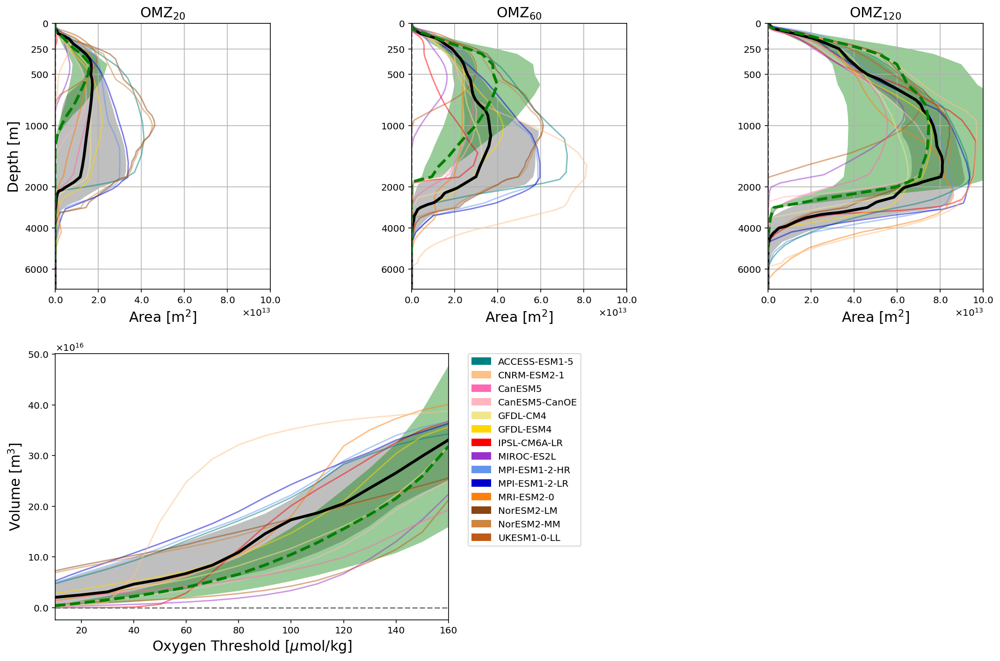

In [8]:
%matplotlib inline
fig = plt.figure(figsize=[15,10])
spec = fig.add_gridspec(ncols=6, nrows=2)
axes = {}
axes['A'] = fig.add_subplot(spec[0, 0:2])
axes['B'] = fig.add_subplot(spec[0, 2:4])
axes['C'] = fig.add_subplot(spec[0, 4:6])
axes['D'] = fig.add_subplot(spec[1, 0:3])


lat_bin = slice(-30,30)

validation_depth_plot(results_historical_volume, obs_historical_volume, 20, lat_bin, axes['A'] )
validation_depth_plot(results_historical_volume, obs_historical_volume, 60, lat_bin, axes['B'] )
validation_depth_plot(results_historical_volume, obs_historical_volume, 120, lat_bin, axes['C'])
axes['B'].set_ylabel('')
axes['C'].set_ylabel('')
axes['A'].set_title(r'$\mathrm{OMZ}_{20}$', fontsize = 15)
axes['B'].set_title(r'$\mathrm{OMZ}_{60}$', fontsize = 15)
axes['C'].set_title(r'$\mathrm{OMZ}_{120}$', fontsize = 15)

validation_oxygen_plot(results_historical_volume, obs_historical_volume, lat_bin, 8000, axes['D'])
axes['D'].set_xlim(10, 160)

plt.tight_layout()

# Figure 3 ab

In [9]:
#for o2 decomposition, calculate time series of difference between value and 1980-2000 mean
def calc_anomolies(ds):

    #compute over OMZ volume gained over 21st century
    o2_gain_anom = ds.o2_gain - ds.o2_gain.sel(time = slice('1980', '2000')).mean(['time'])
    o2sat_gain_anom = ds.o2sat_gain - ds.o2sat_gain.sel(time = slice('1980', '2000')).mean(['time'])
    aou_gain_anom = -ds.aou_gain + ds.aou_gain.sel(time = slice('1980', '2000')).mean(['time'])
    
    #compute over OMZ volume lost over 21st century
    o2_loss_anom = ds.o2_loss - ds.o2_loss.sel(time = slice('1980', '2000')).mean(['time'])
    o2sat_loss_anom = ds.o2sat_loss - ds.o2sat_loss.sel(time = slice('1980', '2000')).mean(['time'])
    aou_loss_anom = -ds.aou_loss + ds.aou_loss.sel(time = slice('1980', '2000')).mean(['time'])
    
    #compute over total volume of change
    o2_anom = (o2_gain_anom*ds.gained_vol + o2_loss_anom*ds.lost_vol) / (ds.gained_vol + ds.lost_vol)
    o2sat_anom = (o2sat_gain_anom*ds.gained_vol + o2sat_loss_anom*ds.lost_vol) / (ds.gained_vol + ds.lost_vol)
    aou_anom = (aou_gain_anom*ds.gained_vol + aou_loss_anom*ds.lost_vol) / (ds.gained_vol + ds.lost_vol)

    return o2_anom, o2sat_anom, aou_anom

In [10]:
#consolidate o2 decomposition results into a single dataset
ds_list = []
for name, ds in results_o2_decomp.items():
    ds_ = ds.sel(time = slice('1980', '2100'))
    ds_list.append(ds_)
ds_o2_decomp = xr.concat(ds_list, dim = 'model')

#calculate changes in o2, o2sat, aou
o2_anom, o2sat_anom, aou_anom = calc_anomolies(ds_o2_decomp)
anom_dict = {'o2_anom':o2_anom, 'o2sat_anom':o2sat_anom, 'aou_anom':aou_anom}

#take trends
trend_dict = {}
for name, da in anom_dict.items(): 
    trend_dict[name] = linear_trend(da.sel(time = slice('2000', '2100')), 'time').slope*101

#average over members
for name,da in trend_dict.items():
    if 'member_id' in list(da.dims):
        trend_dict[name] = da.mean('member_id')

In [11]:
#plot changes in o2, o2sat, aou vs o2 threshold
def oxygen_space_o2_decomp_plot(trend_dict, ax):
    colors = ['orange', 'teal', 'black']
    labels = [r'$\mathrm{O_{2,SAT}}$', '-AOU', r'$\mathrm{O_2}$']
    for i, decomp in enumerate(['o2sat_anom', 'aou_anom', 'o2_anom']):
        ds = trend_dict[decomp]
        
        Median = ds.median('model')
        M1 = ds.quantile(.25, 'model')
        M2 = ds.quantile(.75, 'model')
        
        ax.plot(Median.o2_thresh, Median, color = colors[i], linewidth = 3, label = labels[i])
        ax.fill_between(Median.o2_thresh, M1, M2, alpha = 0.5, color = colors[i], edgecolor = 'none')
        
    ax.axhline(0., color = '0.5', ls='--')
    ax.set_xlim(5,160)
    ax.set_ylabel('Oxygen Trend\n[$\mathrm{\mu mol/kg}$/century]', fontsize = 15)
    ax.set_xlabel(r'Oxygen Threshold [$\mu$mol/kg]', fontsize = 15)
    ax.legend()

    
#Plot integrated OMZ volume trend vs O2 threshold    
def oxygen_space_trend_plot(ddict,lat_bins, lev, ax, models = False):
    colors = o2_model_colors()
    Median_list = []
    o2_range = slice(5, 160)
    ######## PLOT MODEL CURVES ########################
    for name, ds in ddict.items():
        source_id = ds.source_id
        out = ds.slope.sel(lat_bin = lat_bins, o2_bin = o2_range, lev = slice(0,lev)).sum(['lat_bin', 'lev'])
        if models:
            shaded_line_plot(out, 'member_id', line_kwargs=dict(color=colors[source_id]), ax = ax)
        Median_list.append(out.mean(['member_id']))
    ###################################################
    
    ######## PLOT MEDIAN CURVE ########################
    Median = xr.concat(Median_list, 'model').median('model')
    ax.plot(Median.o2_bin, Median, color = 'black', linewidth = 3)
    
    M1 = xr.concat(Median_list, 'model').quantile(.25, dim = 'model')
    M2 = xr.concat(Median_list, 'model').quantile(.75, dim = 'model')
    ax.fill_between(Median.o2_bin, M1, M2, alpha = 0.5, color = 'gray', edgecolor = 'none')
    ###################################################


    ############ FORMATING ###################################
    ax.axhline(0., color = '0.5', ls='--')
    ax_lim_format = 16
    ax.yaxis.set_major_formatter(ScientificManualFormatter(ax_lim_format, "%1.1f"))
    ax.ticklabel_format(
        axis="y", style="sci", scilimits=(-ax_lim_format, ax_lim_format)
    )
    ax.set_xlim(5,160)
    ax.set_ylabel('Volume Trend\n[$\mathrm{m}^3$/century]', fontsize = 15)
    ax.set_xlabel(r'Oxygen Threshold [$\mu$mol/kg]', fontsize = 15)

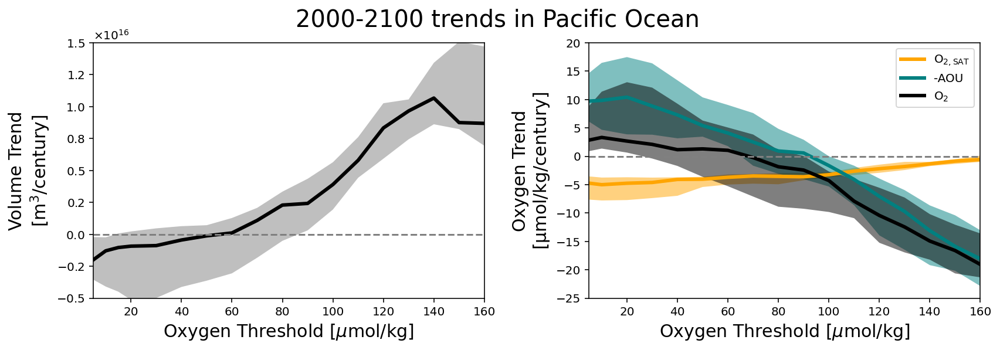

In [12]:
#Figure 3: (a) omz volume trend vs o2 threshold, (b) decomposed o2 trend vs o2 threshold 

%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = [12,4.5])

lat_bin = slice(-30,30)

#validation_oxygen_plot(results_hist_volume, obs_hist, lat_bin, 8000, axes[0])
oxygen_space_trend_plot(results_volume_trend, lat_bin, 8000, axes[0])
oxygen_space_o2_decomp_plot(trend_dict, axes[1])
axes[0].set_ylim(-.5e16, 1.5e16)
axes[1].set_ylim(-25, 20)
axes[0].set_xlim(5, 160)
axes[1].set_xlim(5, 160)
plt.suptitle('2000-2100 trends in Pacific Ocean', fontsize = 20, y = .92)
plt.tight_layout()

In [13]:
ds_list = []
for name, ds in results_vol_ts.items():
    ds_list.append(ds)
ds_vol = xr.concat(ds_list, dim = 'model')

vol_anom = (ds_vol.volume - ds_vol.volume.sel(time = slice('1980', '2000')).mean('time')).mean(['member_id'])

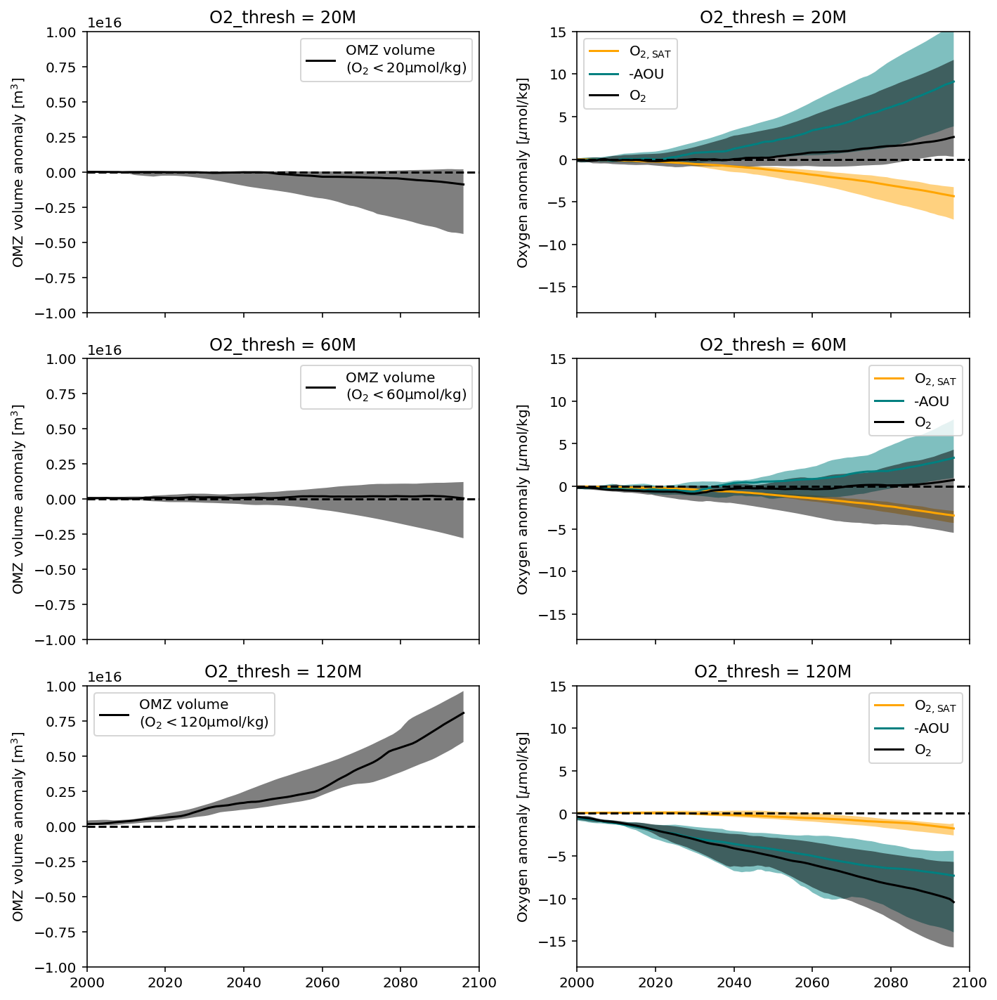

In [14]:
fig, axes = plt.subplots(3,2, figsize = [10, 10], sharex = True)

o2_thresh = [20, 60, 120]
spreadstyle = 'std'
spreads = [1.]
colors = ['orange', 'teal', 'black']
labels = [r'$\mathrm{O_{2,SAT}}$', '-AOU', r'$\mathrm{O_2}$']

for i, o2 in enumerate(o2_thresh):
    Median_vol = vol_anom.sel(o2_bin = o2, method = 'nearest').rolling(time = 10, center = True).mean('time').median(['model'])
    M1_vol = vol_anom.sel(o2_bin = o2, method = 'nearest').rolling(time = 10, center = True).mean('time').quantile(.25, 'model')
    M2_vol = vol_anom.sel(o2_bin = o2, method = 'nearest').rolling(time = 10, center = True).mean('time').quantile(.75, 'model')
    axes[i,0].plot(Median_vol.time, Median_vol, color = 'black', label = 'OMZ volume\n($\mathrm{O_2 < %s \mu mol/kg}$)'%(o2_thresh[i]))
    axes[i,0].fill_between(Median_vol.time, M1_vol, M2_vol, alpha = 0.5, color = 'black', edgecolor = 'none')

    for ii, decomp in enumerate(['o2sat_anom', 'aou_anom', 'o2_anom']):
        ds = anom_dict[decomp].sel(o2_thresh = o2).rolling(time = 10, center = True).mean('time').mean('member_id')
    
        Median = ds.median('model')
        M1 = ds.quantile(.25, 'model')
        M2 = ds.quantile(.75, 'model')
        axes[i,1].plot(Median.time, Median, color = colors[ii], label = labels[ii])
        axes[i,1].fill_between(Median.time, M1, M2, alpha = 0.5, color = colors[ii], edgecolor = 'none')
    

    axes[i,0].set_ylim(-1e16, 1e16)
    axes[i,0].set_xlim(2000, 2100)
    axes[i,0].axhline(0., color = 'black', ls= 'dashed')
    axes[i,0].legend()
    axes[i,0].set_title(f'O2_thresh = {o2_thresh[i]}M')
    axes[i,0].set_ylabel('OMZ volume anomaly [$\mathrm{m}^3$]')
    
    axes[i,1].set_ylim(-18, 15)
    axes[i,1].axhline(0., color = 'black', ls = 'dashed')
    axes[i,1].set_xlim(2000, 2100)
    axes[i,1].legend()
    axes[i,1].set_title(f'O2_thresh = {o2_thresh[i]}M')
    axes[i,1].set_ylabel('Oxygen anomaly [$\mu$mol/kg]')
    plt.tight_layout()

## Figure 4: Maps + Sections of changes

In [15]:
def median_map_plot(
    data,
    contour_data,
    ax,
    vmax=None,
    median_dim='model',
    cmap='RdBu_r',
    rasterized=False,
    units=None,
    name=None
):
    mmm = smooth(data.median(median_dim))
    mmm.name = name
    mmm.attrs['units'] =  units
    
    mmm.plot(
        ax=ax,
        vmax=vmax,
        cmap=cmap,
        rasterized=rasterized,
        **map_kwargs)

    # plot an indicator of the historical OMZ?
    ch = contour_data.plot.contour(
        ax=ax,
        levels=contour_lines,
        colors='k',
        linestyles = ['-', '--', '-.'],
        add_labels=False,
        add_colorbar=False,
        **map_kwargs
    )
    plt.clabel(ch, fmt='%1d')

    sign_agreement(data, mmm, 'model', threshold=sign_threshold).plot.contourf(
        ax=ax,
        levels=[0,0.5],
        hatches=['...',None],
        colors='none',
        add_labels=False,
        add_colorbar=False,
        **map_kwargs
    )
    polish_map(ax)

Dots shows where less than 9.0 models agree on the sign
Dots shows where less than 9.0 models agree on the sign
Dots shows where less than 9.0 models agree on the sign
Dots shows where less than 6.0 models agree on the sign


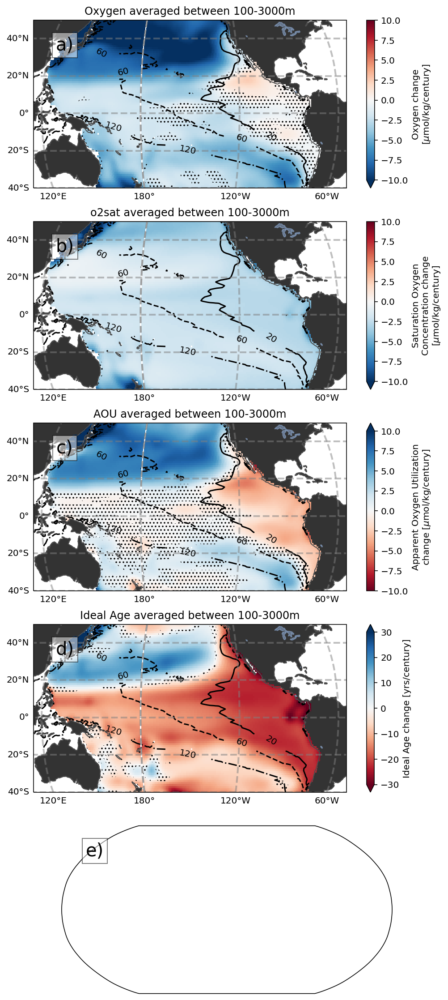

In [16]:
fig, axarr = plt.subplots(
    subplot_kw=dict(projection=projection),
    figsize=[single_figsize_x, single_figsize_y*5,],
    nrows=5,
    ncols=1
)

['o2', 'o2sat', 'aou', 'agessc']


for ax, (ds, title_var, vmax) in zip(
    axarr.flat, 
    [
        (ds_combo_o2, "o2", 10),
        (ds_combo_o2sat, "o2sat", 10),
        (-ds_combo_aou, "aou", 10),
        (ds_combo_age, "agessc", 30),
    ]
):        
    full_name =map_section_unit_cmap_dict[title_var]["full_name"]
    full_title = f'{full_name} averaged between {depth_pattern}'
    
    omz_ref = convert_mol_m3_mymol_kg(ds_boundary_combined.historical_o2_min_value).median('model')
    omz_ref = omz_ref.where(omz_ref<1e10)#.fillna(0)
    
    if title_var in ['o2', 'aou', 'o2sat']:
        ds = convert_mol_m3_mymol_kg(ds)
    
    median_map_plot(
        ds,
        omz_ref,
        ax,
        vmax=vmax,
        median_dim='model',
        cmap=map_section_unit_cmap_dict[title_var]['cmap'],
        rasterized=False,
        name=map_section_unit_cmap_dict[title_var]['name'],
        units=map_section_unit_cmap_dict[title_var]['units'],
    )
    
    n_models = len(ds.model)
    dotted = np.ceil(n_models*sign_threshold)
    print(f'Dots shows where less than {dotted} models agree on the sign')
    
    ax.set_title(f"{full_title}")
#     for section_bound in section_bounds:
#         ax.plot(
#             [section_bound, section_bound],
#             [-50, 50],
#             transform=ccrs.PlateCarree(),
#             color='0.3',
#             lw=1,
#             ls='--'
#         )
letter_subplots(axarr, start_idx=0, fontsize=20, box_color='w')
fig.savefig(pfolder.joinpath(f"Maps.pdf"))

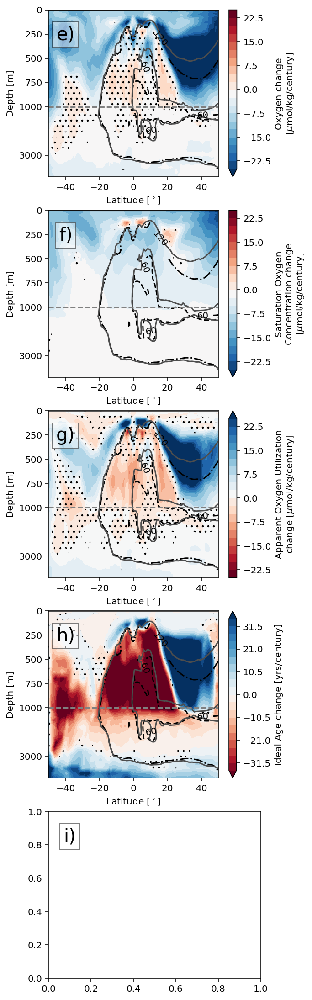

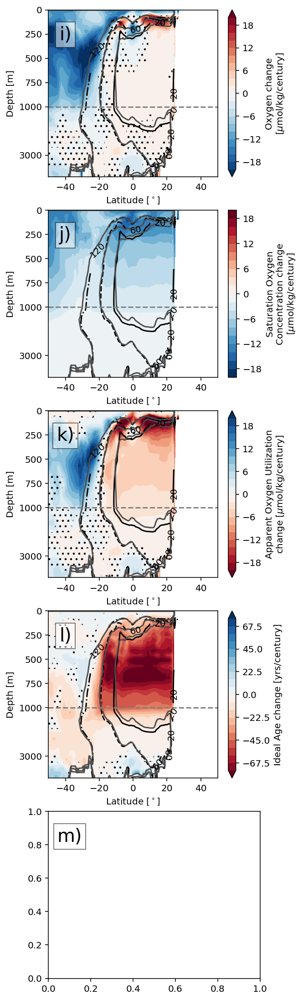

In [39]:
for (x0, x1, oxy_vmax, age_vmax, start_idx) in [(200, 220, 25, 35, 4), (250, 270, 20, 75, 8)]:
    scale_factor = 0.65
    fig, axarr = plt.subplots(
        figsize=[single_figsize_x*0.8*scale_factor, single_figsize_y*1.5*5*scale_factor,],
        nrows=5,
        ncols=1
    )
    ds_section = ds_full_3d_changes.sel(
        y=slice(-50,50),
        lev=slice(None, 4000)
    ).sel(
        x=slice(x0, x1)
    ).mean('x')
    for ax, (da, title_var, vmax) in zip(
        axarr.flat, 
        [
            (ds_section.o2, "o2", oxy_vmax),
            (ds_section.o2sat, "o2sat", oxy_vmax),
            (ds_section.aou, "aou", oxy_vmax),
            (ds_section.agessc, "agessc", age_vmax),
        ]
    ):
        plot_kwargs = dict(ax=ax, yincrease=False)

        da = da.isel(time=1).squeeze()
        cmap = map_section_unit_cmap_dict[title_var]['cmap']

        aggregated = da.median('source_id')
        aggregated.name = map_section_unit_cmap_dict[title_var]['name']
        aggregated.attrs['units'] = map_section_unit_cmap_dict[title_var]['units']


        sign = sign_agreement(da, aggregated, 'source_id',threshold=sign_threshold, count_nans=False)
        aggregated.plot.contourf(levels=21,vmax=vmax, center=0, cmap=cmap, **plot_kwargs)
        sign.plot.contourf(
            colors='none',
            hatches=['..', None],
            levels=[0,0.5],
            add_colorbar=False,
            **plot_kwargs
        )
        ch = ds_section.o2.isel(time=0).median('source_id').plot.contour(
            levels=contour_lines,
            linestyles = ['-', '--', '-.'],
            colors='k',
            **plot_kwargs
        )
        plt.clabel(ch, fmt='%1d')
        ds_section.o2.sum('time').median('source_id').plot.contour(
            levels=contour_lines,
            colors='0.3',
            **plot_kwargs
        )

        linear_piecewise_scale(1000, 3, ax=ax)
        #indicate the point between the different scalings
        ax.axhline(1000, color='0.5', ls='--')
        # Rearange the yticks
        ax.set_yticks([0, 250, 500, 750, 1000, 3000]);
        ax.set_title('')
        ax.set_ylabel('Depth [m]')
        ax.set_xlabel('Latitude [$^\circ$]')
    letter_subplots(axarr, start_idx=start_idx, fontsize=20, box_color='w')
    fig.savefig(pfolder.joinpath(f"Sections-{x0}-{x1}.pdf"))

## Figure 5: Changes in OMZ volume and STC Index

In [18]:
## TODO: temp until sam is done with his stuff
from cmip6_preprocessing.postprocessing import concat_experiments
from busecke_etal_2022_aguadv.utils import stci

In [19]:
ddict_psi = load_directory(dfolder.joinpath('pacific_overturning_new'), naming='dataset_id')
# use source_id as key
ddict_psi = {k.split('.')[2]:v for k,v in ddict_psi.items()}
assert len(ddict_psi)==14

ddict_vol = load_directory(dfolder.joinpath('OMZ_time_series4'), pattern='*.nc', naming='filename')
ddict_vol = {k.replace('_omz_vol',''):v for k,v in ddict_vol.items()}

In [20]:
from matplotlib.lines import Line2D
model_markers = {k:v for k,v in zip(ddict_vol.keys(), Line2D.filled_markers)}

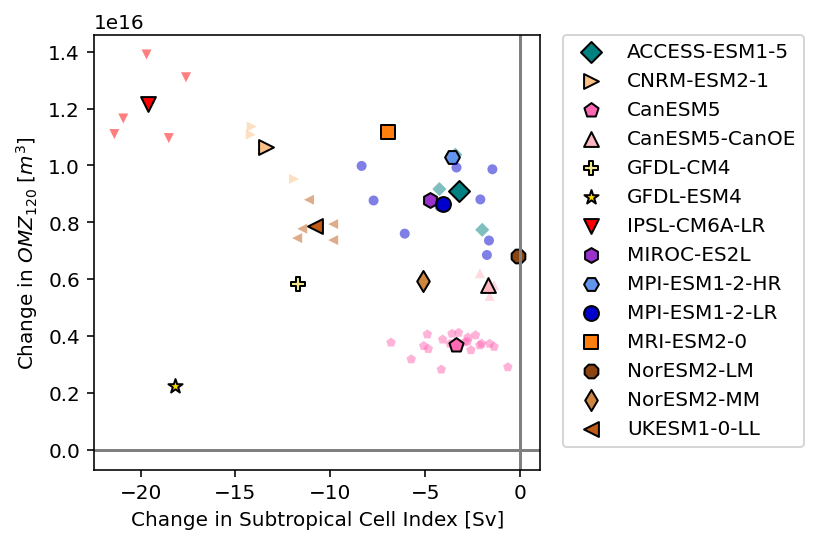

In [21]:
o2=120
fig, ax_scatter = plt.subplots(ncols=1, figsize=[4,4])
for name in sorted(ddict_vol.keys()):
    co = o2_model_colors()[name]

    ds_vol = ddict_vol[name]
    ds_psi = ddict_psi[name]

    stc = stci(ds_psi)
    stc = stc.where((stc>0).all('time'))
    stc = stc/1e6 # convert to sverdrup
    vol = ds_vol.volume
    
    # select only the low oxygenated waters (the bins are centered, thus the offset)
    vol = vol.sel(o2_bin=115)

    # select only relevant time
    stc = stc.sel(time=slice('1850', '2100')).load()
    vol = vol.sel(time=slice('1850', '2100')).load()

    # align the members
    stc, vol = xr.align(stc, vol, join='inner', exclude='time')
    
    x = stc
    y = vol
    
    x,_ = slope(x.sel(time=trend_slice))
    y,_ = slope(y.sel(time=trend_slice))

    ax_scatter.scatter(x.data, y.data, color=co, edgecolor='none', alpha=0.5, s=25, marker=model_markers.get(name, None))
    ax_scatter.scatter(x.mean('member_id').data, y.mean('member_id').data, color=co, edgecolor='k', marker=model_markers.get(name, None),s=55, label=name)
    ax_scatter.set_ylabel('Change in $OMZ_{120}$ [$m^3$]')
    ax_scatter.set_xlabel('Change in Subtropical Cell Index [Sv]')

    ax_scatter.axhline(0, color='0.5')
    ax_scatter.axvline(0, color='0.5')
    
    ax_scatter.legend(
        bbox_to_anchor=(1.05, 1),
        loc="upper left",
        borderaxespad=0.0,
    )
    
fig.savefig(pfolder.joinpath('STC.pdf'))

## Figure 6: Biological changes

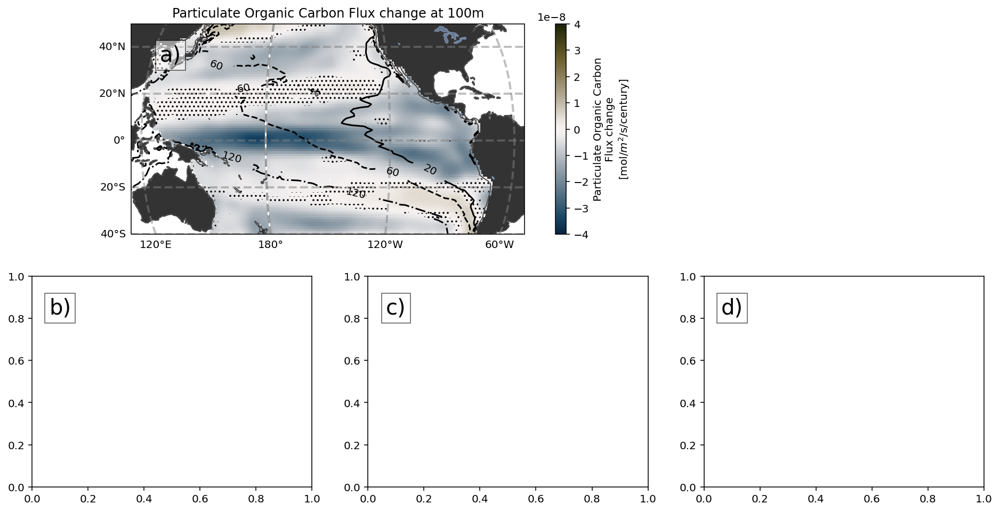

In [22]:
fig = plt.figure(figsize = [single_figsize_x*2, single_figsize_y*2])
nrows = 3
gs = fig.add_gridspec(2, 3)

ax_map = fig.add_subplot(gs[0,:-1], projection=projection)
axarr = [fig.add_subplot(gs[1,i]) for i in range(nrows)]

# print epc median map
ds = ds_combo_epc100
omz_ref = convert_mol_m3_mymol_kg(ds_boundary_combined.historical_o2_min_value).median('model')
omz_ref = omz_ref.where(omz_ref<1e10)
name = map_section_unit_cmap_dict['epc100']['name']
full_title = f'{name} at 100m'
vmax = 4e-8
median_map_plot(
        ds,
        omz_ref,
        ax_map,
        vmax=vmax,
        cmap=cmo.diff,
        rasterized=False,
        name=name,
        units=map_section_unit_cmap_dict['epc100']['units'],
    )


ax_map.set_title(f"{full_title}")


letter_subplots(np.array([ax_map]+axarr), start_idx=0, fontsize=20, box_color='w')
fig.savefig(pfolder.joinpath('bio_argument.pdf'))

# Time Series in Figure 6

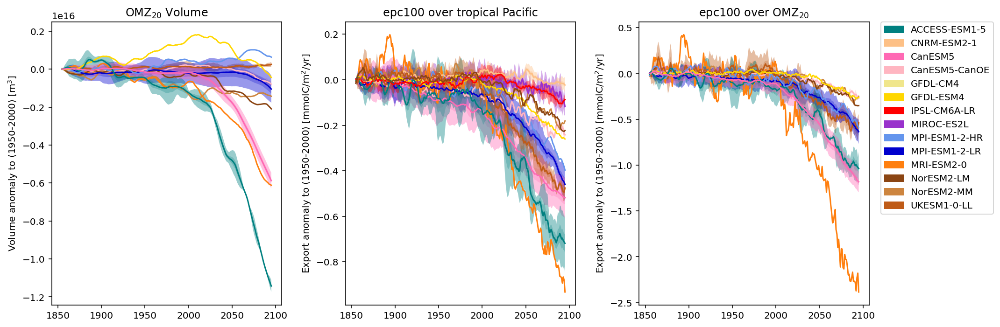

In [23]:
#rolling window size for smoothing
wnd = 10

#convert from s-1 to yr-1
convert_export = (86400)*365.25 #s/day * day/yr

fig, ax = plt.subplots(1,3, figsize = [15, 5])
colors = o2_model_colors()

for name, ds in results_epc_core.items():
    ###########VOLUME TIME SERIES###############
    ax[0].set_ylabel(r'Volume anomaly to (1950-2000) [$\rm{m^3}$]')
    vol_out = (ds.omz_vol - ds.omz_vol.sel(time=slice('1850','1860')).mean(['time']))
    vol_out = vol_out.sel(time = slice('1850', '2100')).rolling(time = wnd, center = True).mean().isel(time=slice(5,-5))
    shaded_line_plot(vol_out, 'member_id',  line_kwargs=dict(color=colors[ds.source_id]), ax = ax[0])

    
    #########EXPORT TIME SERIES ###############
    ax[2].set_ylabel(r'Export anomaly to (1950-2000) [$\rm{mmolC/m^2/yr}$]')
    epc_out = (ds.epc100 - ds.epc100.sel(time=slice('1850','1860')).mean(['time']))*convert_export
    epc_out = epc_out.sel(time = slice('1850', '2100')).rolling(time = wnd, center = True).mean().isel(time=slice(5,-5))
    shaded_line_plot(epc_out, 'member_id', line_kwargs=dict(color=colors[ds.source_id]), ax = ax[2])

for name, ds in results_epc_outer.items():
    #########EXPORT TIME SERIES ###############
    ax[1].set_ylabel(r'Export anomaly to (1950-2000) [$\rm{mmolC/m^2/yr}$]')
    epc_out = (ds.epc100 - ds.epc100.sel(time=slice('1850','1860')).mean(['time']))*convert_export
    epc_out = epc_out.sel(time = slice('1850', '2100')).rolling(time = wnd, center = True).mean().isel(time=slice(5,-5))
    shaded_line_plot(epc_out, 'member_id', line_kwargs=dict(color=colors[ds.source_id]), ax = ax[1])

model_color_legend()

ax[0].set_title('$\mathrm{OMZ_{20}}$ Volume')
ax[1].set_title('epc100 over tropical Pacific')
ax[2].set_title('epc100 over $\mathrm{OMZ_{20}}$')

plt.tight_layout()

## Figure 7: Relationship to OMZ boundary

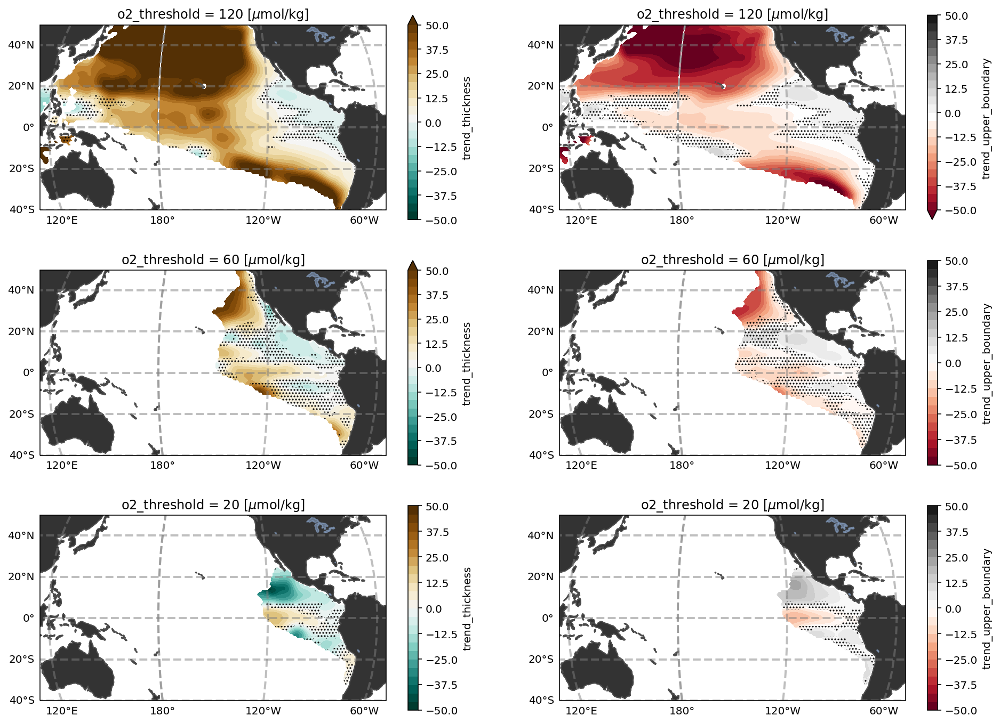

In [24]:
from xarrayutils.utils import sign_agreement
ds = ds_boundary_combined.drop_sel(model='obs_bianchi')

fig, axarr_full = plt.subplots(
    nrows=len(o2_th),
    ncols=2,
    subplot_kw={'projection':projection},
    figsize=[single_figsize_x*2, single_figsize_y*len(o2_th)],
)

for ai, (var, vmax, levels, cmap) in enumerate(
    [
        ('trend_thickness', 50, 25, 'BrBG_r'),
        ('trend_upper_boundary', 50, 25, 'RdGy')
    ]):
    da = ds[var]
    axarr = axarr_full[:,ai]
    
    # mask out the areas that do not have many models with an OMZ there.
    nan_mask = mask_multi_model(da)
    
    m = da.median('model').where(nan_mask).load()
    m = smooth(m)
    s = sign_agreement(da, m, 'model', count_nans=False, threshold=sign_threshold).where(nan_mask)
    # values shown where at least 10 models have an OMZ
    # areas that are not dotted have at least 7 models with that sign

    for o2, ax in zip(np.flip(o2_th), axarr):
        m.sel(o2_threshold=o2).plot.contourf(ax=ax, vmax=vmax, cmap=cmap, levels=levels,rasterized=True, **map_kwargs)
        s.sel(o2_threshold=o2).plot.contourf(
            ax=ax,
            levels=[0,0.5],
            hatches=['....', None],
            colors='none',
            add_labels=False, 
            add_colorbar=False,
            **map_kwargs)
        polish_map(ax)
fig.savefig(pfolder.joinpath(f"Thickness_Boundary.pdf"))

----------
upper-20
<xarray.Dataset>
Dimensions:    ()
Data variables:
    slope      float64 -0.5597
    intercept  float64 -2.488
    r_value    float64 -0.6587
    p_value    float64 0.0
    std_err    float64 0.003132
----------
upper-60
<xarray.Dataset>
Dimensions:    ()
Data variables:
    slope      float64 -0.61
    intercept  float64 1.459
    r_value    float64 -0.679
    p_value    float64 0.0
    std_err    float64 0.002154
----------
upper-120
<xarray.Dataset>
Dimensions:    ()
Data variables:
    slope      float64 -0.595
    intercept  float64 0.9761
    r_value    float64 -0.5603
    p_value    float64 0.0
    std_err    float64 0.002056


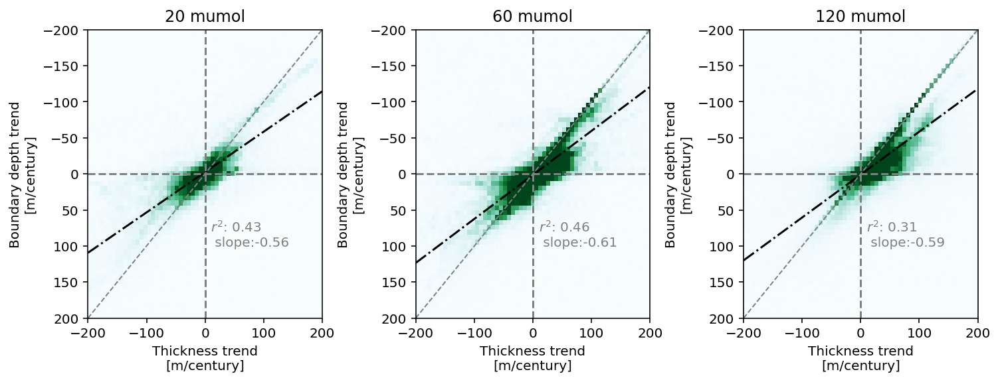

In [25]:
co = 'k'
slope_dict = {}

ds_scatter = ds_boundary_combined.drop_sel(model=['obs_bianchi'])

fig, axarr = plt.subplots(nrows=1, ncols=3, figsize=[12, 4])
for th, ax in [(core_o2, axarr[0]), (middle_o2, axarr[1]), (outer_o2, axarr[2])]:
    boundary = 'upper'

    if boundary == 'lower':
        y_var = 'trend_lower_boundary'
        diagonal_sign = 1
    else:
        y_var = 'trend_upper_boundary'
        diagonal_sign = -1
    outer_bin = 200
    x_bins = np.linspace(-outer_bin, outer_bin, 60)
    y_bins = np.linspace(-outer_bin, outer_bin, 60)
    x = ds_scatter.sel(o2_threshold=th).trend_thickness
    y = ds_scatter.sel(o2_threshold=th)[y_var]

    hist = histogram(x, y, bins=[x_bins, y_bins])
    hist.plot(
        ax=ax,
        vmin=0,
        vmax=500 if th == outer_o2 else 200,
        add_colorbar=False,
        x='trend_thickness_bin',
        cmap='BuGn',
        rasterized=True,
    )

    # flattern the arrays
    x_flat = x.load().data.reshape(-1, 1)
    y_flat = y.load().data.reshape(-1, 1)

    # remove the nans
    nan_mask = np.isnan(x_flat).reshape(-1, 1)
    x_flat = x_flat[~nan_mask]
    y_flat = y_flat[~nan_mask]

    # remove values that show very large thickness increase to prevent outliers
    large_value_mask = abs(x_flat) < outer_bin
    x_flat = x_flat[large_value_mask]
    y_flat = y_flat[large_value_mask]

    reg = xr_linregress(
        xr.DataArray(x_flat, dims=['dummy']),
        xr.DataArray(y_flat, dims=['dummy']),
        'dummy'
    ).load()

    line = x_bins * reg.slope.data + reg.intercept.data
    print('----------')
    print(f'{boundary}-{th}')
    print(reg)
    ax.text(10, 100, f"$r^2$: {reg.r_value.data**2:.2f} \n slope:{reg.slope.data:.2f}", color='0.5')
    ax.plot(x_bins, line, color='k', ls='-.')


    outer_bin_plot = outer_bin
    ax.set_xlim(-outer_bin_plot, outer_bin_plot)
    ax.set_ylim(outer_bin_plot, -outer_bin_plot)
    ax.axhline(0, color='0.5', ls='--')
    ax.axvline(0, color='0.5', ls='--')
    # plot expected line
    ax.plot(x_bins, diagonal_sign * x_bins, ls='--', lw=1, color='0.5')
    ax.set_xlabel('Thickness trend\n[m/century]')
    ax.set_ylabel(f'Boundary depth trend\n[m/century]')
    ax.set_title(f'{th} mumol')
fig.subplots_adjust(hspace=0.4, wspace=0.4)
fig.savefig(pfolder.joinpath(f"Thickness_Boundary_Scatter.pdf"))

# Extras

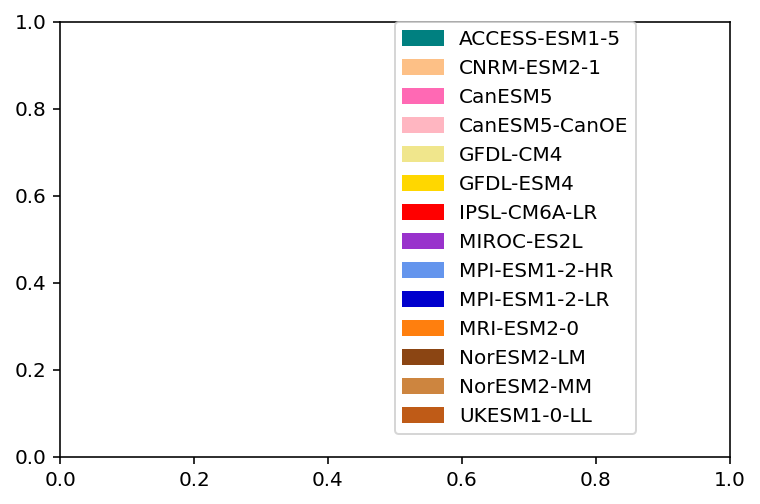

In [26]:
# just a blank legend
plt.figure()
model_color_legend(bbox_to_anchor=[0.5, 1])
plt.savefig(pfolder.joinpath('legend.pdf'))

# SI

## SI: thickness/boundary

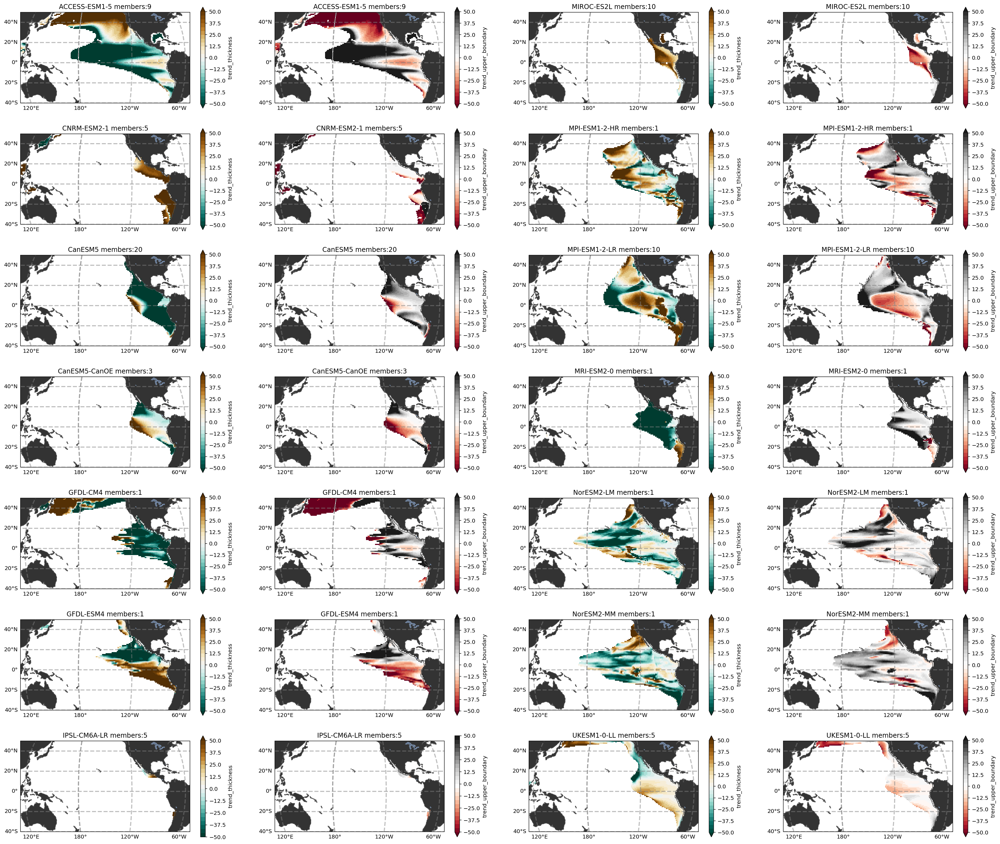

thickness_upper_20_SI.pdf


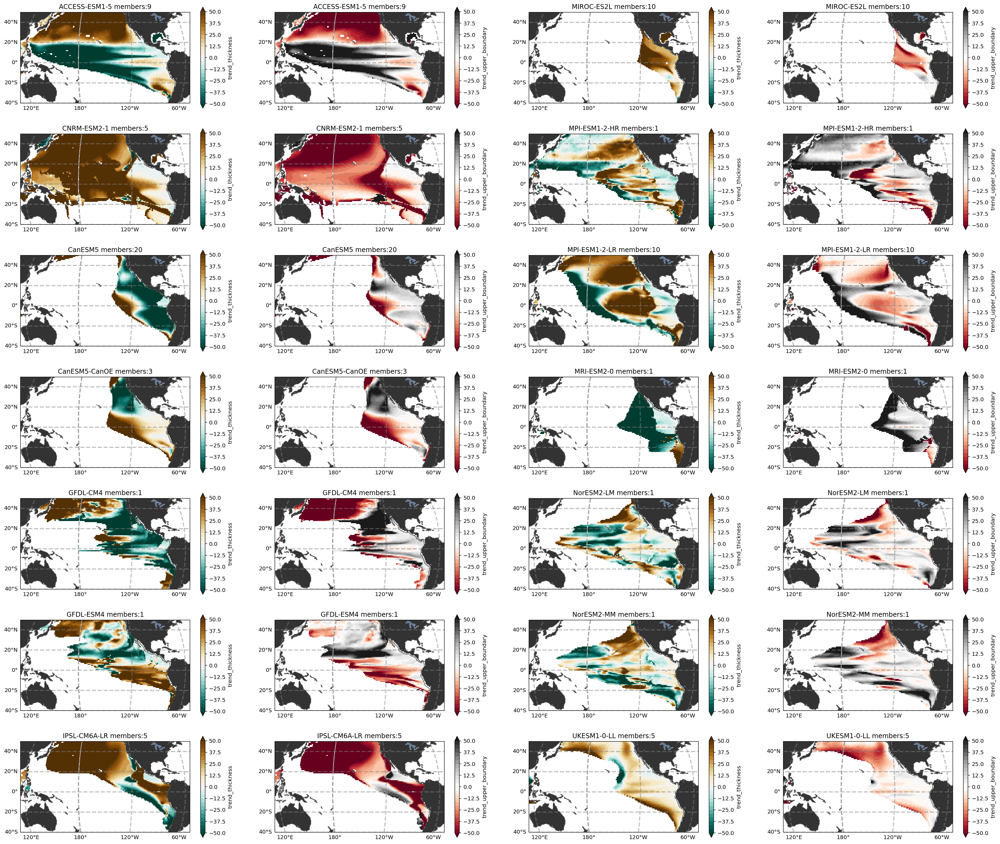

thickness_upper_60_SI.pdf


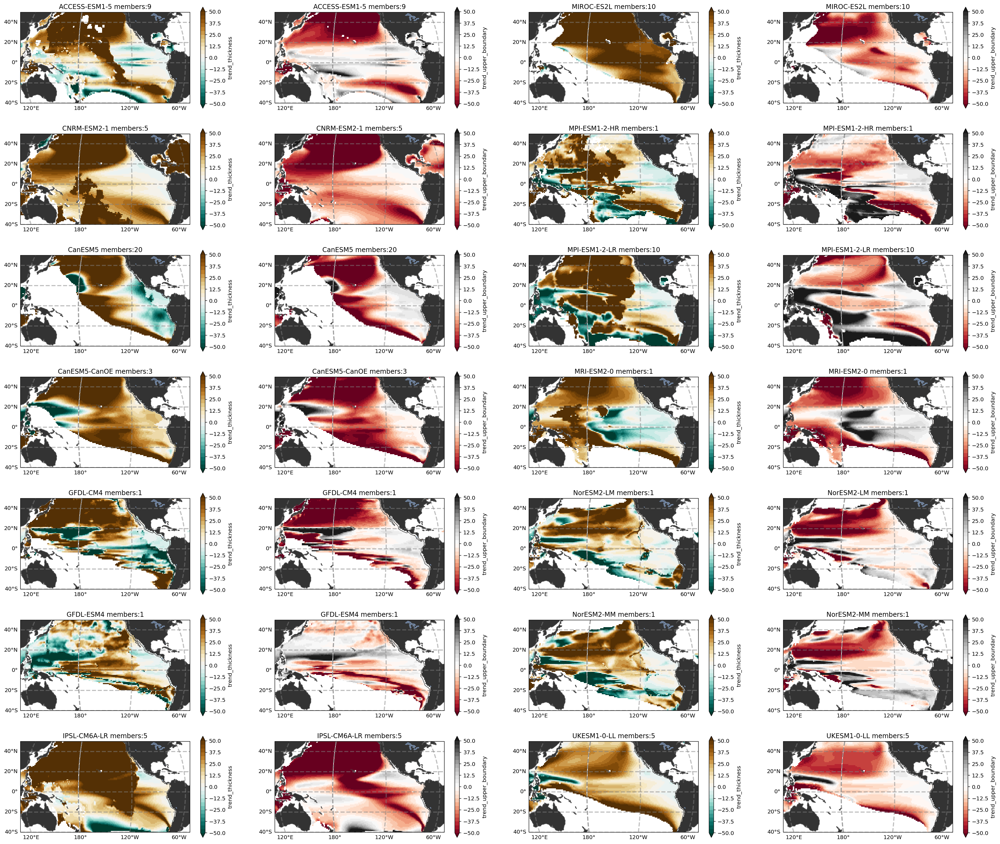

thickness_upper_120_SI.pdf


In [27]:
ds = ds_boundary_combined.drop_sel(model='obs_bianchi')


for oi, o2 in enumerate(o2_th):
    fig, axarr = plt.subplots(
        ncols=4,
        nrows=len(ds.model.data)//2,
        subplot_kw={'projection':projection},
        figsize=[single_figsize_x*4,single_figsize_y*len(ds.model.data)//2],
    )

    for vi, (var, vmax, levels, cmap, axarr_sub) in enumerate(
        [
        ('trend_thickness', 50, 25, 'BrBG_r', list(axarr[:,0].flat)+list(axarr[:,2].flat)),
        ('trend_upper_boundary', 50, 25, 'RdGy',list(axarr[:,1].flat)+list(axarr[:,3].flat))
        ]):
        da = ds[var]
        for mi, (ax, model) in enumerate(zip(axarr_sub, da.model.data)):
            m = da.sel(model=model)
#             m = smooth(m)
            m.sel(o2_threshold=o2).plot(
                ax=ax,
                vmax=vmax,
                cmap=cmap,
                levels=levels,
                rasterized=True,
                **map_kwargs
            )
            polish_map(ax)
            ax.set_title(f"{model} members:{m.averaged_members.load().data}")
    plt.show()
    filename = f"thickness_upper_{o2}_SI.pdf"
    print(filename)
    fig.savefig(pfolder.joinpath(filename))

## SI: Sections

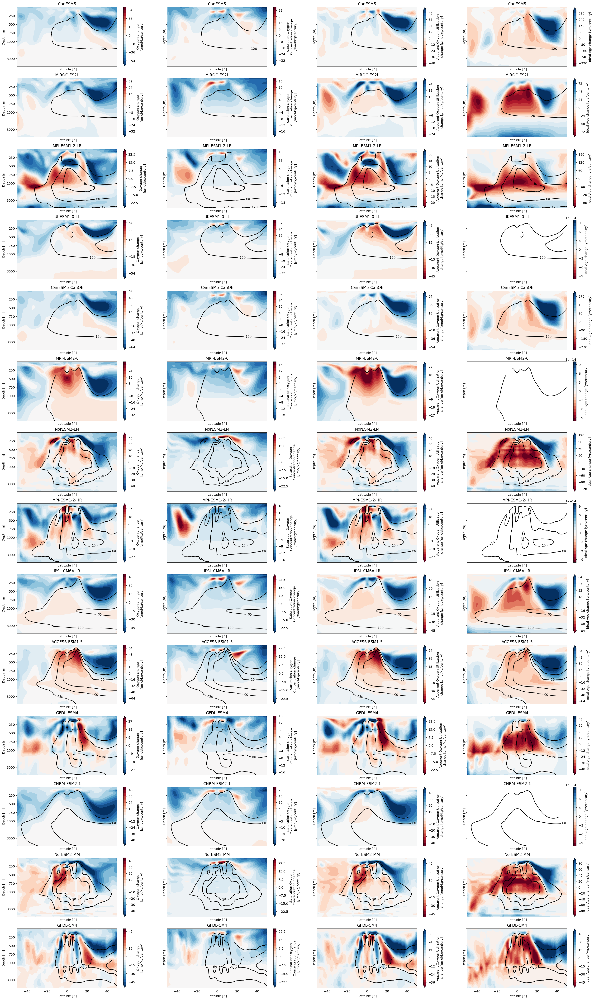

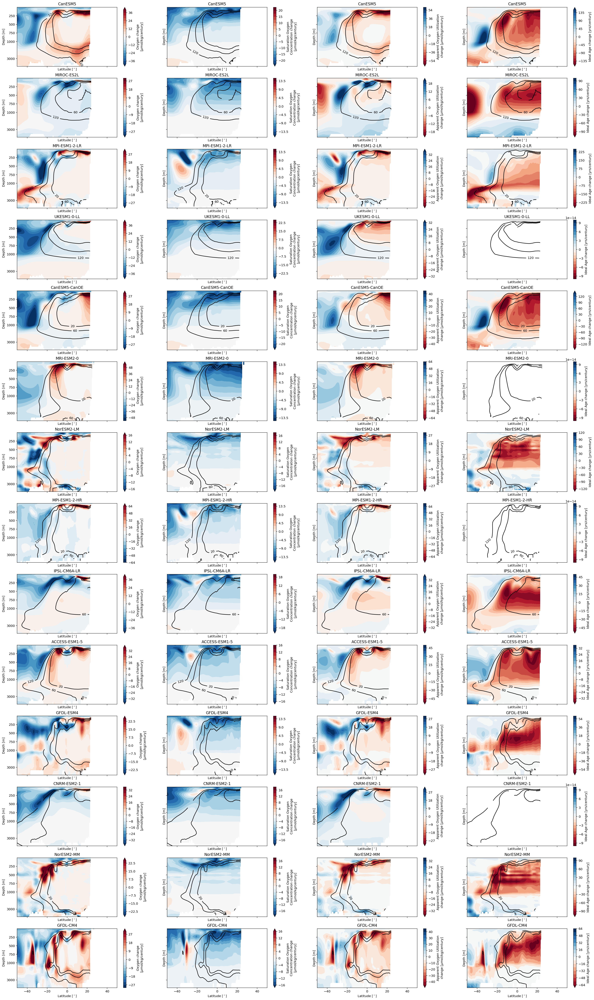

In [28]:
for (x0, x1) in [(200, 220), (250, 270)]:
    ds_section = ds_full_3d_changes.sel(
        y=slice(-50,50),
        lev=slice(None, 4000)
    ).sel(
        x=slice(x0, x1)
    ).mean('x')

    fig, axarr = plt.subplots(ncols=4, nrows=14, sharex=True, sharey=True, figsize=[single_figsize_x*4,single_figsize_y*14])
    for source_id, sub_axarr in zip(ds_section.source_id.data, [axarr[i,:] for i in range(14)]):
        for var, ax in zip(['o2', 'o2sat', 'aou', 'agessc'], sub_axarr.flat):
            plot_kwargs = dict(ax=ax, yincrease=False)
            ds = ds_section.sel(source_id=source_id).isel(time=1).squeeze()

            da = ds[var].squeeze()
            da.name = map_section_unit_cmap_dict[var]['name']
            da.attrs['units'] = map_section_unit_cmap_dict[var]['units']

            da.plot.contourf(
                levels=21,
                robust=True,
                center=0,
                rasterized=True,
                cmap=map_section_unit_cmap_dict[var]['cmap'],
                **plot_kwargs)
            ch = ds_section.sel(source_id=source_id).isel(time=0).o2.plot.contour(
                levels=contour_lines,
                colors='k',
                **plot_kwargs
            )
            plt.clabel(ch, fmt='%1d')

            linear_piecewise_scale(1000, 3, ax=ax)
            # Rearange the yticks
            ax.set_yticks([0, 250, 500, 750, 1000, 3000]);
            ax.set_title('')
            ax.set_ylabel('Depth [m]')
            ax.set_xlabel('Latitude [$^\circ$]')
            ax.set_title(f'{source_id}')
    fig.savefig(pfolder.joinpath(f'section_SI-{x0}-{x1}.pdf'))

## Figure S5

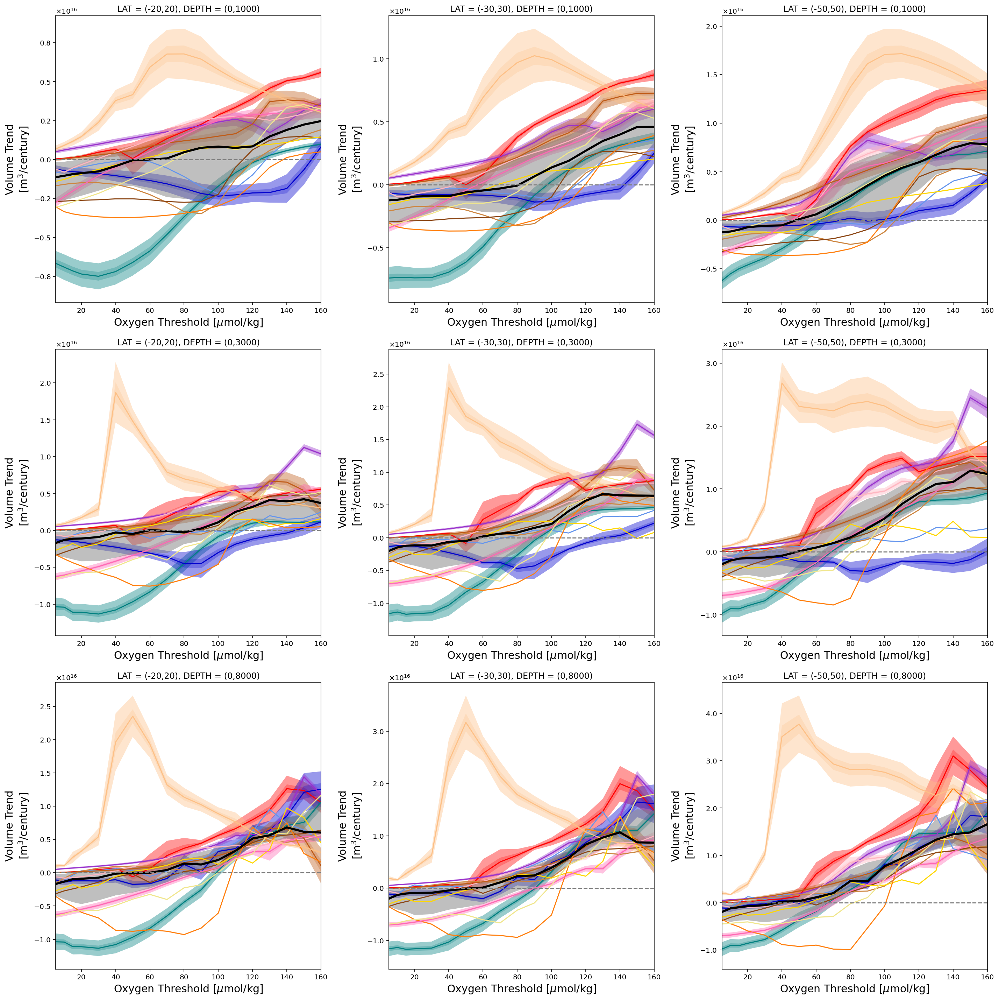

In [29]:
n = 3
m = 3
fig, axes = plt.subplots(n,m, figsize = [20,20])
lev = [1000, 3000, 8000]
lats = [20, 30, 50]

for i in range(m):
    for j in range(n):
        axes[j,i].set_title(f'LAT = (-{lats[i]},{lats[i]}), DEPTH = (0,{lev[j]})')
        oxygen_space_trend_plot(results_volume_trend, slice(-lats[i], lats[i]), lev[j], axes[j,i], models = True)
        
plt.tight_layout()

# Tables S1, S2, S3

In [30]:
def convert_to_cumulative_volume(hist):
    hist_cumu = hist.cumsum("o2_bin")
    hist_cumu = hist_cumu.assign_coords(o2_bin=hist.o2_bin)
    return hist_cumu
basin_bins = ['North Pacific Ocean','South Pacific Ocean']
lat_bins = slice(-30,30)


ds_obs = convert_to_cumulative_volume(obs_histogram).sel(
    basin_mask_bin = basin_bins, lat_bin = lat_bins).sum(['basin_mask_bin', 'lat_bin', 'lev'])

In [31]:
ddict_tables = {}
for name, ds in results_vol_ts.items():
    ds['trend'] = linear_trend(ds.volume.sel(time = slice('2000', '2100')), 'time').slope.load()*101.
    ds['p_value'] = linear_trend(ds.volume.sel(time = slice('2000', '2100')), 'time').p_value.load()
    ds['hist_vol'] = ds.volume.sel(time=slice('1950','2000')).mean(['time']).load()
    ddict_tables[name] = ds

In [32]:
def make_table(o2_thresh):
    
    obs = ds_obs.volume.sel(o2_bin = o2_thresh, method = 'nearest')
    
    table_dict = {'name': [],
                  '# mem.': [],
                 r'volume ($\rm{m}^3$)':[],
                 'vol. std.':[],
                  'volume (% obs.)': [],
                 r'trend ($\rm{m^3/cen}$)':[],
                 'trend std.':[],
                  'trend (% change)': [],
                'trend p-value':[],
                }
    
    for name, ds in ddict_tables.items():
        ds_ = ds.sel(o2_bin = o2_thresh, method = 'nearest').median(['member_id'])
        
        table_dict['name'].append(ds.source_id)
        table_dict['# mem.'].append(len(ds.member_id))
        table_dict[r'volume ($\rm{m}^3$)'].append(ds_.hist_vol.values)#'{:.2e}'.format(ds_.hist_vol.values))
        table_dict['volume (% obs.)'].append(int(np.rint((ds_.hist_vol/obs).values*100)))
        
        table_dict[r'trend ($\rm{m^3/cen}$)'].append(ds_.trend.values)#'{:.2e}'.format(ds_.trend.values))
        table_dict['trend (% change)'].append(int(np.rint(ds_.trend.values/ds_.hist_vol.values*100)))
        
        if ds.p_value.sel(o2_bin = o2_thresh, method = 'nearest').max(['member_id']).values < 0.05:
            table_dict[r'trend p-value'].append('o')
        else:
            table_dict[r'trend p-value'].append('x')
        
        if len(ds.member_id) > 1:
            table_dict['vol. std.'].append(ds.hist_vol.sel(
            o2_bin = o2_thresh, method = 'nearest').std(['member_id']).values)
            table_dict['trend std.'].append(ds.trend.sel(
            o2_bin = o2_thresh, method = 'nearest').std(['member_id']).values)
        else:
            table_dict['vol. std.'].append('--')
            table_dict['trend std.'].append('--')
    
    DF_models = pd.DataFrame.from_dict(table_dict)
    
    
    #Add Observations
    WOA = {'name': ['WOA'],
                  '# mem.': ['--'],
                 r'volume ($\rm{m}^3$)':obs.values,#['{:.1e}'.format(obs.values)],
                 'vol. std.':['--'],
                  'volume (% obs.)': ['--'],
                 r'trend ($\rm{m^3/cen}$)':['--'],
                 'trend std.':['--'],
                  'trend (% change)': ['--'],
                'trend p-value':['--']
                }
    
    WOA = pd.DataFrame.from_dict(WOA)
    
    
    #Add Multi-model median
    MMM = {'name': ['MMM'],
                  '# mem.': [14],
                 r'volume ($\rm{m}^3$)':[],
                 'vol. std.':[],
                  'volume (% obs.)': [],
                 r'trend ($\rm{m^3/cen}$)':[],
                 'trend std.':[],
                  'trend (% change)': [],
                'trend p-value':['--']
                }
    
    MMM[r'volume ($\rm{m}^3$)'].append(DF_models[r'volume ($\rm{m}^3$)'].median())#'{:.2e}'.format(DF_models[r'volume ($\rm{m}^3$)'].median()))
    MMM['volume (% obs.)'].append(int(np.rint(DF_models['volume (% obs.)'].median())))
    std = np.std(DF_models[r'volume ($\rm{m}^3$)'].values.astype(np.float))
    #MMM['vol. std.'].append('{:.1e}'.format(std))
    MMM['vol. std.'].append('--')
    
    MMM[r'trend ($\rm{m^3/cen}$)'].append(DF_models[r'trend ($\rm{m^3/cen}$)'].median())
    
    #Not sure which method is 'right' here
    #MMM['trend (% change)'].append(int(np.rint(DF_models['trend (% change)'].median())))
    MMM['trend (% change)'].append(int(np.rint(
        DF_models[r'trend ($\rm{m^3/cen}$)'].median()/DF_models[r'volume ($\rm{m}^3$)'].median()*100)))
    
    std = np.std(DF_models[r'trend ($\rm{m^3/cen}$)'].values.astype(np.float))
    #MMM['trend std.'].append('{:.1e}'.format(std))
    MMM['trend std.'].append('--')
    
    MMM = pd.DataFrame.from_dict(MMM)
    
    DF = pd.concat([WOA, MMM, DF_models]).reset_index(drop = True)
    
    return DF

In [33]:
def trunc_display(df):
    
    for i, row in df.iterrows():
        row[r'volume ($\rm{m}^3$)'] = '{:.2f}'.format(float(row[r'volume ($\rm{m}^3$)'])*1e-16)
        if row[r'trend ($\rm{m^3/cen}$)'] != '--':
            row[r'trend ($\rm{m^3/cen}$)'] = '{:.2f}'.format(float(row[r'trend ($\rm{m^3/cen}$)'])*1e-16)
        if row['vol. std.'] != '--':
            row['vol. std.'] = '{:.2f}'.format(float(row['vol. std.'])*1e-16)
        if row['trend std.'] != '--':
            row['trend std.'] = '{:.2f}'.format(float(row['trend std.'])*1e-16)
    return df

In [34]:
#OMZ20
Table = make_table(20)
trunc_display(Table)

,name,# mem.,volume ($\rm{m}^3$),vol. std.,volume (% obs.),trend ($\rm{m^3/cen}$),trend std.,trend (% change),trend p-value
0,WOA,--,1.23,--,--,--,--,--,--
1,MMM,14,2.53,--,205,-0.09,--,-4,--
2,MPI-ESM1-2-LR,10,7.22,0.04,587,-0.08,0.04,-1,x
3,IPSL-CM6A-LR,5,0.01,0.00,1,0.02,0.00,371,o
4,CanESM5-CanOE,3,1.11,0.00,90,-0.10,0.01,-9,o
5,UKESM1-0-LL,5,0.88,0.02,72,0.02,0.01,2,x
6,CNRM-ESM2-1,5,0.49,0.06,39,0.36,0.04,75,o
7,NorESM2-LM,1,8.35,--,679,-0.22,--,-3,o
8,MRI-ESM2-0,1,2.12,--,172,-0.60,--,-28,o
9,CanESM5,20,2.27,0.03,184,-0.66,0.03,-29,o


In [35]:
#OMZ60
Table = make_table(60)
trunc_display(Table)

,name,# mem.,volume ($\rm{m}^3$),vol. std.,volume (% obs.),trend ($\rm{m^3/cen}$),trend std.,trend (% change),trend p-value
0,WOA,--,4.57,--,--,--,--,--,--
1,MMM,14,6.74,--,147,0.01,--,0,--
2,MPI-ESM1-2-LR,10,14.53,0.06,318,-0.18,0.05,-1,o
3,IPSL-CM6A-LR,5,2.91,0.06,64,0.24,0.18,8,o
4,CanESM5-CanOE,3,3.44,0.01,75,0.12,0.02,3,o
5,UKESM1-0-LL,5,1.90,0.06,42,0.13,0.02,7,o
6,CNRM-ESM2-1,5,25.00,0.34,547,2.64,0.16,11,o
7,NorESM2-LM,1,12.42,--,272,-0.10,--,-1,o
8,MRI-ESM2-0,1,6.32,--,138,-0.89,--,-14,o
9,CanESM5,20,4.22,0.04,92,-0.34,0.03,-8,o


In [36]:
#OMZ120
Table = make_table(120)
trunc_display(Table)

,name,# mem.,volume ($\rm{m}^3$),vol. std.,volume (% obs.),trend ($\rm{m^3/cen}$),trend std.,trend (% change),trend p-value
0,WOA,--,16.95,--,--,--,--,--,--
1,MMM,14,20.53,--,122,0.83,--,4,--
2,MPI-ESM1-2-LR,10,28.65,0.12,169,0.88,0.11,3,o
3,IPSL-CM6A-LR,5,26.48,0.48,156,1.18,0.12,4,o
4,CanESM5-CanOE,3,12.23,0.04,72,0.59,0.03,5,o
5,UKESM1-0-LL,5,7.01,0.42,41,0.79,0.05,11,o
6,CNRM-ESM2-1,5,36.95,0.04,218,1.12,0.09,3,o
7,NorESM2-LM,1,20.08,--,119,0.69,--,3,o
8,MRI-ESM2-0,1,31.87,--,188,1.13,--,4,o
9,CanESM5,20,9.93,0.11,59,0.38,0.04,4,o
